# 데이터 불러오기

본 경진대회는 CPU RAM이 8GB 밖에 없어서 난항을 겪었지만, CPU가 아닌 TPU VM v3-8로 변경하면 CPU RAM이 330GB까지 늘어난다. 하지만 경진대회의 룰이 GPU가 아닌 CPU만으로 예측해야하므로 탐색적 분석, 모델 생성, 하이퍼파라미터 설정, 모델 성능 검증 까지 해보고 좋은 모델과 파라미터를 저장하여 CPU에서 불러와 제출하겠습니다.

이 경진대회의 목표는 결국 학생들의 지난 게임 로그를 활용하여 학생ID, Session 레벨에 따른 정답 유무 (0-오답, 1-정답)을 예측합니다.

참고로 이 자료는 다음 자료들을 참고하였습니다.
- [@Chris Deotte](https://www.kaggle.com/cdeotte) 님의 [Game Room Click EDA](https://www.kaggle.com/code/cdeotte/game-room-click-eda)
- [@Nguyen Thi Cam Lai](https://www.kaggle.com/nguyenthicamlai) 님의 [🔥 EDA & ML on Game Play 🎮 (ongoing)](https://www.kaggle.com/code/nguyenthicamlai/eda-ml-on-game-play-ongoing)
- [@Paul Bacher](https://www.kaggle.com/paulbacher) 님의 [🎓[Detailed EDA] Student Perf from Game Play](https://www.kaggle.com/code/paulbacher/detailed-eda-student-perf-from-game-play)
- [@Demid Chernenko](https://www.kaggle.com/demche) 님의 [Student Performance from Game Play - EDA](https://www.kaggle.com/code/demche/student-performance-from-game-play-eda)
- [@PΣTR PΣTRUK](https://www.kaggle.com/asimple) 님의 [🎯EDA~[Game Play]🎮](https://www.kaggle.com/code/asimple/eda-game-play)

어느 부분을 참고하였는지, 추가적인 참고자료는 코드설명에도 따로 표시해놓겠습니다.

In [176]:
import pandas as pd

data_path = '/kaggle/input/predict-student-performance-from-game-play/'

train = pd.read_csv(data_path + 'train.csv')
test = pd.read_csv(data_path + 'test.csv')
train_labels = pd.read_csv(data_path + 'train_labels.csv')
submission = pd.read_csv(data_path + 'sample_submission.csv')

In [177]:
print('train shape, test shape, train_labels shape, submission shape')

train.shape, test.shape, train_labels.shape, submission.shape

train shape, test shape, train_labels shape, submission shape


((26296946, 20), (3728, 21), (424116, 2), (54, 3))

## 데이터 사이즈 줄이기

train과 test의 데이터를 살펴보면 데이터의 크기가 커 데이터를 살펴볼 때, 시간과 용량차지가 높습니다. 그래서 데이터의 사이즈를 줄여보도록하겠습니다.  
다음은 [@Demid Chernenko](https://www.kaggle.com/demche)님의 코드를 참고했습니다. [notebook](https://www.kaggle.com/code/demche/student-performance-from-game-play-eda)

In [178]:
import pandas as pd
import numpy as np

In [179]:
def reduce_memory_usage(df, df_name):
    start_mem = df.memory_usage(index=True, deep=True).sum() / 1024**2
    print(f'Initial memory usage of {df_name} dataframe is {round(start_mem, 2)} MB')    
    for col in df.columns:
        col_type = df[col].dtype.name
        if ((col_type != 'datetime64[ns]') & (col_type != 'category')):
            if (col_type != 'object'):
                c_min = df[col].min()
                c_max = df[col].max()
                if str(col_type)[:3] == 'int':
                    if c_min > np.iinfo(np.int8).min and c_max < np.iinfo(np.int8).max:
                        df[col] = df[col].astype(np.int8)
                    elif c_min > np.iinfo(np.int16).min and c_max < np.iinfo(np.int16).max:
                        df[col] = df[col].astype(np.int16)
                    elif c_min > np.iinfo(np.int32).min and c_max < np.iinfo(np.int32).max:
                        df[col] = df[col].astype(np.int32)
                    elif c_min > np.iinfo(np.int64).min and c_max < np.iinfo(np.int64).max:
                        df[col] = df[col].astype(np.int64)
                else:
                    if c_min > np.finfo(np.float16).min and c_max < np.finfo(np.float16).max:
                        df[col] = df[col].astype(np.float16)
                    elif c_min > np.finfo(np.float32).min and c_max < np.finfo(np.float32).max:
                        df[col] = df[col].astype(np.float32)
                    else:
                        pass
            else:
                df[col] = df[col].astype('category')
    mem_usg = df.memory_usage(index=True, deep=True).sum() / 1024**2 
    print(f"Memory usage of {df_name} became: {round(mem_usg, 2)} MB")    
    return df

train = reduce_memory_usage(train, 'train')
test = reduce_memory_usage(test, 'test')
#labels = reduce_memory_usage(labels, 'labels')

Initial memory usage of train dataframe is 13793.15 MB
Memory usage of train became: 1028.33 MB
Initial memory usage of test dataframe is 1.96 MB
Memory usage of test became: 0.22 MB


In [180]:
train.head()

,session_id,index,elapsed_time,event_name,name,level,page,room_coor_x,room_coor_y,screen_coor_x,screen_coor_y,hover_duration,text,fqid,room_fqid,text_fqid,fullscreen,hq,music,level_group
0,20090312431273200,0,0,cutscene_click,basic,0,NaN,-414.0,-159.375,380.0,494.0,NaN,undefined,intro,tunic.historicalsociety.closet,tunic.historicalsociety.closet.intro,0,0,1,0-4
1,20090312431273200,1,1323,person_click,basic,0,NaN,-414.0,-159.375,380.0,494.0,NaN,"Whatcha doing over there, Jo?",gramps,tunic.historicalsociety.closet,tunic.historicalsociety.closet.gramps.intro_0_...,0,0,1,0-4
2,20090312431273200,2,831,person_click,basic,0,NaN,-414.0,-159.375,380.0,494.0,NaN,Just talking to Teddy.,gramps,tunic.historicalsociety.closet,tunic.historicalsociety.closet.gramps.intro_0_...,0,0,1,0-4
3,20090312431273200,3,1147,person_click,basic,0,NaN,-414.0,-159.375,380.0,494.0,NaN,I gotta run to my meeting!,gramps,tunic.historicalsociety.closet,tunic.historicalsociety.closet.gramps.intro_0_...,0,0,1,0-4
4,20090312431273200,4,1863,person_click,basic,0,NaN,-413.0,-159.375,381.0,494.0,NaN,"Can I come, Gramps?",gramps,tunic.historicalsociety.closet,tunic.historicalsociety.closet.gramps.intro_0_...,0,0,1,0-4


In [181]:
test.head()

,session_id,index,elapsed_time,event_name,name,level,page,room_coor_x,room_coor_y,screen_coor_x,...,hover_duration,text,fqid,room_fqid,text_fqid,fullscreen,hq,music,level_group,session_level
0,20090109393214576,0,0,cutscene_click,basic,0,NaN,-414.0,75.6875,380.0,...,NaN,undefined,intro,tunic.historicalsociety.closet,tunic.historicalsociety.closet.intro,0,0,1,0-4,0
1,20090109393214576,1,1965,person_click,basic,0,NaN,-106.0,-63.3125,688.0,...,NaN,"Whatcha doing over there, Jo?",gramps,tunic.historicalsociety.closet,tunic.historicalsociety.closet.gramps.intro_0_...,0,0,1,0-4,0
2,20090109393214576,2,3614,person_click,basic,0,NaN,-419.0,47.6875,375.0,...,NaN,Just talking to Teddy.,gramps,tunic.historicalsociety.closet,tunic.historicalsociety.closet.gramps.intro_0_...,0,0,1,0-4,0
3,20090109393214576,3,5330,person_click,basic,0,NaN,-111.0,-57.3125,683.0,...,NaN,I gotta run to my meeting!,gramps,tunic.historicalsociety.closet,tunic.historicalsociety.closet.gramps.intro_0_...,0,0,1,0-4,0
4,20090109393214576,4,6397,person_click,basic,0,NaN,-111.0,-57.3125,683.0,...,NaN,"Can I come, Gramps?",gramps,tunic.historicalsociety.closet,tunic.historicalsociety.closet.gramps.intro_0_...,0,0,1,0-4,0


### 피처 요약 함수 만들기

In [182]:
def resumetable(df):
    print(f'데이터셋 형상 : {df.shape}')
    summary = pd.DataFrame(df.dtypes, columns=['데이터 타입'])
    summary = summary.reset_index()
    summary = summary.rename(columns={'index':'피처'})
    summary['결측값 개수'] = df.isnull().sum().values
    summary['고윳값 개수'] = df.nunique().values
    summary['첫 번째 값'] = df.loc[0].values
    summary['두 번째 값'] = df.loc[1].values
    summary['세 번째 값'] = df.loc[2].values
    
    return summary

In [183]:
resumetable(train)

데이터셋 형상 : (26296946, 20)


,피처,데이터 타입,결측값 개수,고윳값 개수,첫 번째 값,두 번째 값,세 번째 값
0,session_id,int64,0,23562,20090312431273200,20090312431273200,20090312431273200
1,index,int16,0,20348,0,1,2
2,elapsed_time,int32,0,5042639,0,1323,831
3,event_name,category,0,11,cutscene_click,person_click,person_click
4,name,category,0,6,basic,basic,basic
5,level,int8,0,23,0,0,0
6,page,float16,25732402,7,NaN,NaN,NaN
7,room_coor_x,float16,2073272,29854,-414.0,-414.0,-414.0
8,room_coor_y,float16,2073272,27847,-159.375,-159.375,-159.375
9,screen_coor_x,float16,2073272,6866,380.0,380.0,380.0


In [184]:
resumetable(test)

데이터셋 형상 : (3728, 21)


,피처,데이터 타입,결측값 개수,고윳값 개수,첫 번째 값,두 번째 값,세 번째 값
0,session_id,int64,0,3,20090109393214576,20090109393214576,20090109393214576
1,index,int16,0,1564,0,1,2
2,elapsed_time,int32,0,3720,0,1965,3614
3,event_name,category,0,11,cutscene_click,person_click,person_click
4,name,category,0,6,basic,basic,basic
5,level,int8,0,23,0,0,0
6,page,float16,3575,7,NaN,NaN,NaN
7,room_coor_x,float16,362,2390,-414.0,-106.0,-419.0
8,room_coor_y,float16,362,2038,75.6875,-63.3125,47.6875
9,screen_coor_x,float16,362,801,380.0,688.0,375.0


In [185]:
submission.head()

,session_id,correct,session_level
0,20090109393214576_q1,0,0
1,20090312143683264_q1,0,0
2,20090312331414616_q1,0,0
3,20090109393214576_q2,0,0
4,20090312143683264_q2,0,0


### 결측값

In [186]:
!pip install missingno

You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.


<AxesSubplot: >

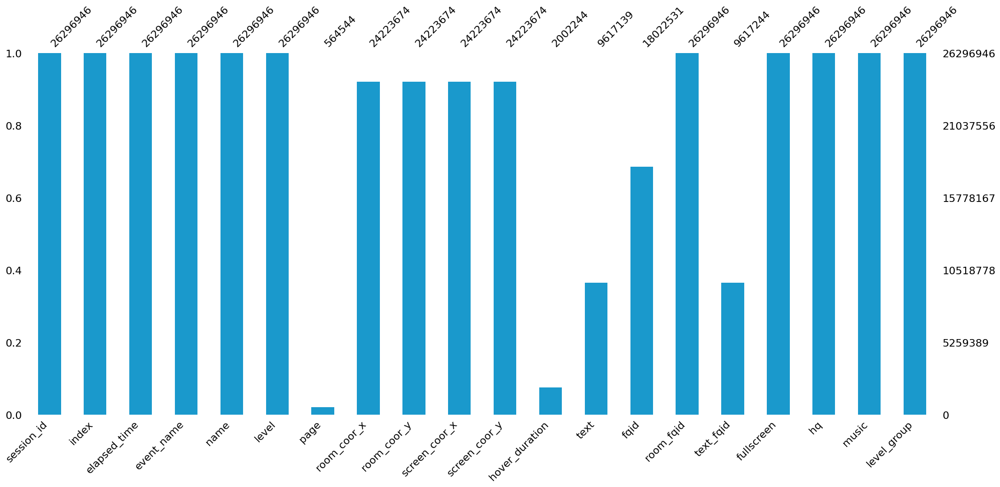

In [187]:
import missingno as msno

msno.bar(df=train.iloc[:,:], color=(0.1, 0.6, 0.8))

<AxesSubplot: >

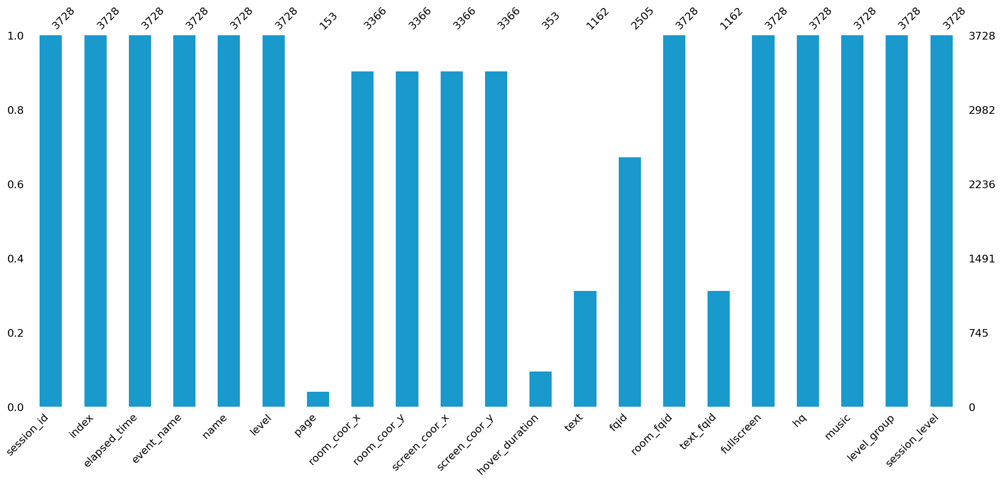

In [188]:
msno.bar(df=test.iloc[:,:], color=(0.1, 0.6, 0.8))

- train과 test의 결측값 분포를 보니 비슷한 양상이어서 나중에 훈련을 할 때 결측값 관련해서는 train과 test에 같이 적용하면 될 것 같다.
- 피처들의 결측값을 보면 fullscreen, hq, music은 결측값이 너무 많아 제거해야할 것 같다.
- 그 다음으로 결측값이 많은 page, hover_duration, text, fqid, text_fqid는 후에 살펴보기
- train에는 없는 test에 session_level 피처가 있어 제거를 해야한다.

In [189]:
train.drop(columns=['fullscreen', 'hq', 'music'], inplace=True)
test.drop(columns=['fullscreen', 'hq', 'music'], inplace=True)

In [190]:
test.drop(columns=['session_level'], inplace=True)

### 고윳값 확인

- 비교적 분포가 적은 변수의 고윳값들을 확인해보면...
- train - event_name, name, level, page, room_fqid, level_group
- test - session_id, event_name, name, level, page, room_fqid, level_group, session_group 이다.
- 하지만 train과 test의 공동 변수들의 고윳값 개수가 같으므로 train에서 한 번만 살펴보겠다.

In [191]:
features = ['event_name', 'name', 'level', 'page', 'room_fqid', 'level_group']

for feature in features:
    print(f'{feature} 고윳값 : {train[feature].unique()}\n')

event_name 고윳값 : ['cutscene_click', 'person_click', 'navigate_click', 'observation_click', 'notification_click', ..., 'object_hover', 'map_hover', 'map_click', 'checkpoint', 'notebook_click']
Length: 11
Categories (11, object): ['checkpoint', 'cutscene_click', 'map_click', 'map_hover', ..., 'object_click', 'object_hover', 'observation_click', 'person_click']

name 고윳값 : ['basic', 'undefined', 'close', 'open', 'prev', 'next']
Categories (6, object): ['basic', 'close', 'next', 'open', 'prev', 'undefined']

level 고윳값 : [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14 15 16 17 18 19 20 21 22]

page 고윳값 : [nan  0.  1.  3.  4.  5.  6.  2.]

room_fqid 고윳값 : ['tunic.historicalsociety.closet', 'tunic.historicalsociety.basement', 'tunic.historicalsociety.entry', 'tunic.historicalsociety.collection', 'tunic.historicalsociety.stacks', ..., 'tunic.historicalsociety.cage', 'tunic.historicalsociety.collection_flag', 'tunic.wildlife.center', 'tunic.flaghouse.entry', 'tunic.capitol_2.hall']
Length: 19
Cat

- event_name에서 '_'를 기준으로 나눠보기
- room_fqid는 '.'을 기준으로 나눠서 첫번째 tunic은 공통이니까 2, 3번째 원소로 새롭게 만들기


In [192]:
print('text 고윳값 확인 : ',train['text'].unique())

text 고윳값 확인 :  ['undefined', 'Whatcha doing over there, Jo?', 'Just talking to Teddy.', 'I gotta run to my meeting!', 'Can I come, Gramps?', ..., 'Come on, Jo!', 'Meet me back in my office and we'll get start..., 'Here I am!', 'Wells sabotaged Gramps!', 'AND he stole Teddy!']
Length: 598
Categories (597, object): ['*COUGH COUGH COUGH*', '*cough cough*', '*grumble grumble*', 'A boring old shirt.', ..., '\u00f0\u0178\u02dc\u00b4', '\u00f0\u0178\u02dc\u0160', '\u00f0\u0178\u2122\u201e', 'undefined']


In [193]:
print('fqid 고윳값 확인 : ', train['fqid'].unique())

fqid 고윳값 확인 :  ['intro', 'gramps', 'teddy', 'photo', NaN, ..., 'block_badge', 'fox', 'block_badge_2', 'block_1', 'chap2_finale']
Length: 129
Categories (128, object): ['archivist', 'archivist_glasses', 'block', 'block_0', ..., 'wells', 'wellsbadge', 'what_happened', 'worker']


In [194]:
print('text_fqid 고윳값 확인 : ', train['text_fqid'].unique())

text_fqid 고윳값 확인 :  ['tunic.historicalsociety.closet.intro', 'tunic.historicalsociety.closet.gramps.intro_0..., 'tunic.historicalsociety.closet.teddy.intro_0_..., NaN, 'tunic.historicalsociety.closet.teddy.intro_0_..., ..., 'tunic.wildlife.center.fox.concern', 'tunic.library.frontdesk.block_badge_2', 'tunic.historicalsociety.entry.gramps.hub', 'tunic.humanecology.frontdesk.block_1', 'tunic.drycleaner.frontdesk.block_1']
Length: 127
Categories (126, object): ['tunic.capitol_0.hall.boss.talktogramps', 'tunic.capitol_0.hall.chap1_finale_c', 'tunic.capitol_1.hall.boss.haveyougotit', 'tunic.capitol_1.hall.boss.writeitup', ..., 'tunic.wildlife.center.wells.animals', 'tunic.wildlife.center.wells.animals2', 'tunic.wildlife.center.wells.nodeer', 'tunic.wildlife.center.wells.nodeer_recap']


- text와 fqid는 제거
- text_fqid는 room_fqid와 비슷하게 설정

## 시각화

In [195]:
!pip install wordcloud

You should consider upgrading via the '/usr/local/bin/python -m pip install --upgrade pip' command.


In [196]:
import seaborn as sns
import matplotlib as mpl
import matplotlib.pyplot as plt
from wordcloud import WordCloud # wordcloud를 위한 importing (event properties - fqid에서 사용)
import matplotlib.image as img
%matplotlib inline

### 1. 타깃값 분포

In [197]:
def write_percentage(ax, total_size):
    '''도형 객체를 순회하며 막대 상단에 타깃값 비율 표시'''
    for patch in ax.patches:
        height = patch.get_height()
        width = patch.get_width()
        left_coord = patch.get_x()
        percent = height/total_size*100
        
        ax.text(x=left_coord + width/2.0,
                y=height + total_size*0.001,
                s=f'{percent:1.1f}%',
                ha='center')

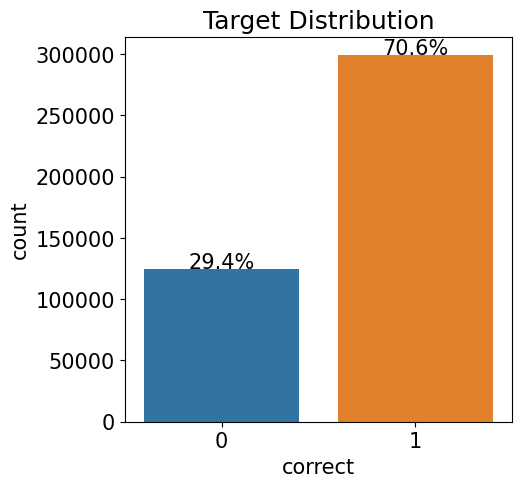

In [198]:
mpl.rc('font', size=15)
plt.figure(figsize=(5, 5))

# 타깃값 분포 카운트 플롯
ax = sns.countplot(x='correct', data=train_labels)
write_percentage(ax, len(train_labels))
ax.set_title('Target Distribution')
plt.show()

train의 타깃값은 정답(1)이 70.4%, 오답(0)이 29.6%로 불균형적입니다.  

#### 1. Question number - correct 

train_labels에서 sessino_id를 보면 '_'으로 나눴을때 2번째가 question number인 것을 알 수 있다. 그래서 session_id에서 question number을 추출한 뒤, question number 별 correct의 비율을 시각화해보겠습니다.

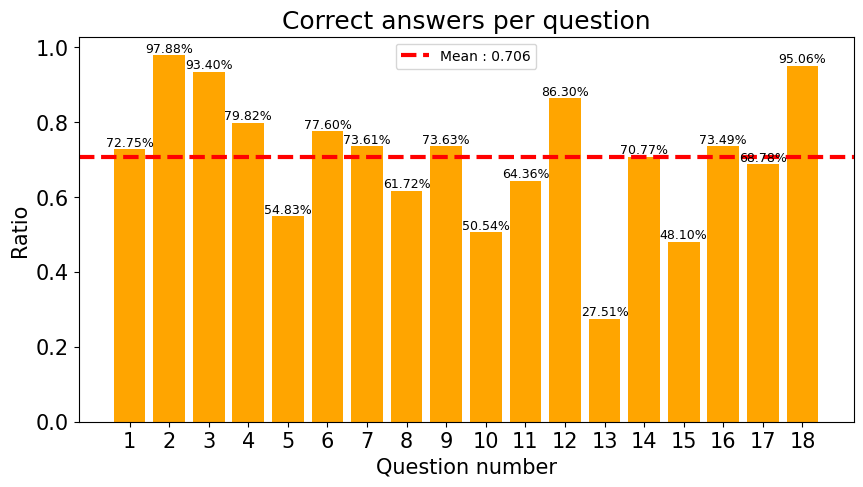

In [199]:
# question 피처 추출
train_labels['question'] = train_labels['session_id'].apply(lambda x: int(x.split('_')[1][1:]))

# question 별 정답률
correct_ratios = []
for q in range(1, 19):
    tmp = train_labels[train_labels['question'] == q]['correct']
    ratio = tmp.sum() / len(tmp)
    correct_ratios.append(ratio)
    
x_range = range(1, 19)
mean = np.mean(correct_ratios)
plt.figure(figsize=(10,5))
plt.bar(x=x_range, height=correct_ratios, color='orange')
for i, v in enumerate(x_range):
    plt.text(v, correct_ratios[i], s=f'{correct_ratios[i] * 100:.2f}%', fontsize = 9,
             horizontalalignment='center', verticalalignment='bottom')
plt.axhline(mean, color='red', ls='--', lw=3)
# x범위를 x_range로 변환
plt.xticks(x_range)
plt.legend([f'Mean : {mean:.3f}'], fontsize='10')
plt.title('Correct answers per question')
plt.xlabel('Question number')
plt.ylabel('Ratio')
plt.show()

일단 정답률의 평균은 70.6%로 위 타깃별 분포에서도 나와있습니다. 그러면 question number 별로 비교를 해보자면...

- 대체로 question number 별 정답률은 평균을 넘었다.
- 2, 3, 18 번에서 90% 이상의 높은 정답률을 기록하였다. 
- 13번 문제는 27.51%로 최저 정답률을 기록하였다.

하지만 train 데이터들과 train_labels의 데이터들을 병합하기위해서는 일대일로 매칭되는 점이 없기 때문에(session_id로 합치면 q1-q18의 기준이 없음) question number 피처는 학습에 사용하지 못할 것 같습니다.

In [200]:
train_labels[['session_id_id', 'question_number']] = train_labels['session_id'].str.split('_', 1, expand=True)
train_labels['session_id_id'] = train_labels['session_id_id'].astype(np.int64)

/tmp/ipykernel_14/2071846120.py:1: FutureWarning: In a future version of pandas all arguments of StringMethods.split except for the argument 'pat' will be keyword-only.
  train_labels[['session_id_id', 'question_number']] = train_labels['session_id'].str.split('_', 1, expand=True)


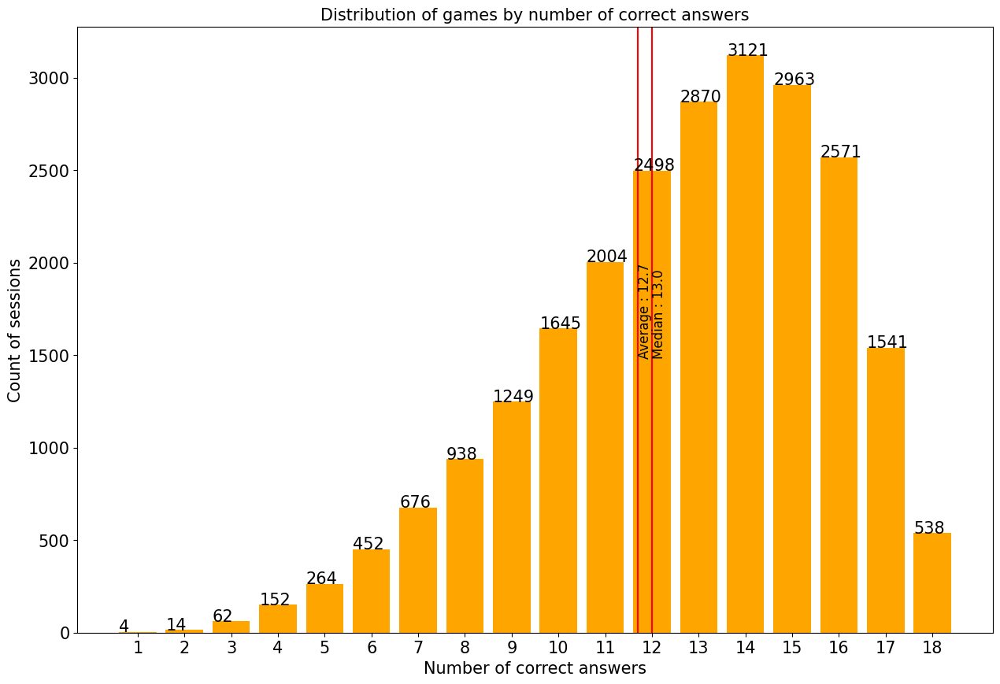

In [201]:
correct_answers_per_session = train_labels.groupby('session_id_id')['correct'].sum()
mean_correct_answers_per_session = correct_answers_per_session.mean()
median_correct_answers_per_session = correct_answers_per_session.median()
correct_answers_per_session = correct_answers_per_session.value_counts()
plt.figure(figsize=(15, 10))
plt.bar(x=correct_answers_per_session.index, height=correct_answers_per_session.values, color='orange')
plt.title('Distribution of games by number of correct answers', fontsize=15)
plt.xticks(x_range)
plt.xlabel('Number of correct answers')
plt.ylabel('Count of sessions')
plt.axvline(x=mean_correct_answers_per_session-1, color='red')
plt.text(mean_correct_answers_per_session-1, 1500, f'Average : {round(mean_correct_answers_per_session, 1)}', rotation=90, fontsize=12)
plt.axvline(x=median_correct_answers_per_session-1, color='red')
plt.text(median_correct_answers_per_session-1, 1500, f'Median : {round(median_correct_answers_per_session, 1)}', rotation=90, fontsize=12)
for i, v in enumerate(correct_answers_per_session.sort_index().values):
    plt.text(i+0.6, v, str(int(v)))
plt.show()

train 데이터를 기반으로 몇 문제를 맞췄는지의 사람 수를 확인해봤습니다. 
- 1문제를 맞춘사람은 4명이고, 모든 문제를 맞춘사람은 538명입니다. 
- 14문제를 맞춘 사람이 제일 많습니다.
- 평균적으로 12.7문제를 맞췄습니다.

### 2. Session_id
Session_id는 사용자의 고유번호를 나타낸다.

In [202]:
print('train의 session id 고윳값 : ', len(train['session_id'].unique()))
print('train_labels의 session id 고윳값 : ', len(train_labels['session_id'].apply(lambda x: x.split('_')[0]).unique()))
print('test의 session id 고윳값 : ', len(test['session_id'].unique()))
print('submission의 session id 고윳값 : ', len(submission['session_id'].apply(lambda x: x.split('_')[0]).unique()))

train의 session id 고윳값 :  23562
train_labels의 session id 고윳값 :  23562
test의 session id 고윳값 :  3
submission의 session id 고윳값 :  3


train에는 23562개의 session_id 값들이 존재하고 (종복있음) 거기에 따른 정답값이 train_labels에 있어 train과 train_labels의 session_id 고윳값은 같습니다.  
마찬가지로 test의 session_id 고윳값과 submission의 session_id 고윳값이 같습니다. 특이한 점은 test의 session_id 고윳값이 3개 뿐이라는 점입니다. 

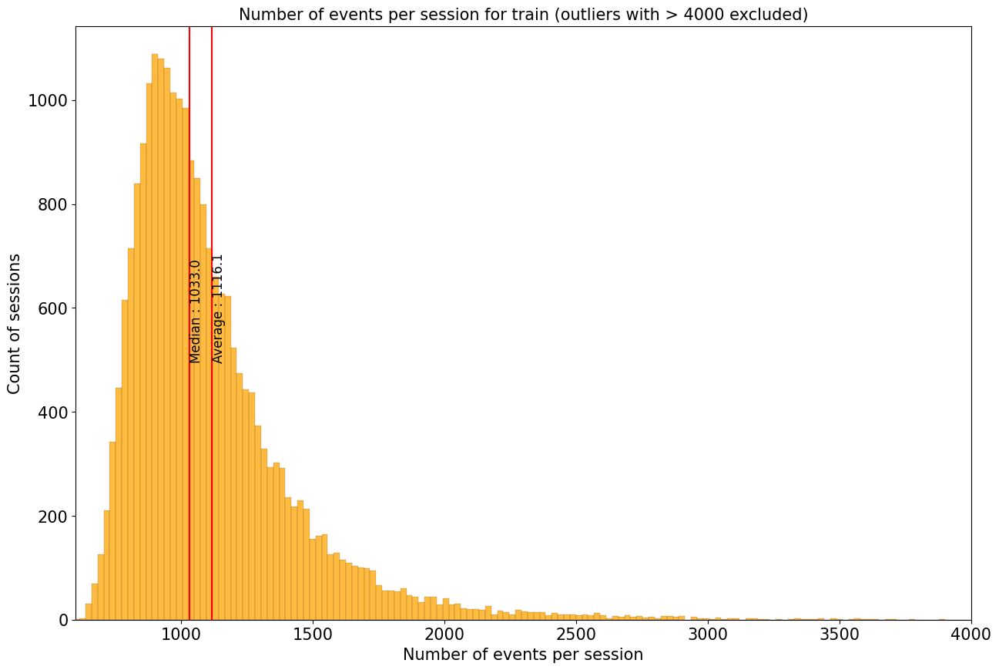

In [203]:
train_events_count = train['session_id'].value_counts()
mean_train_events_count = train_events_count.mean()
median_train_events_count = train_events_count.median()
plt.figure(figsize=(15, 10))
g = sns.histplot(data=train_events_count, color='orange')
plt.title('Number of events per session for train (outliers with > 4000 excluded)', fontsize=15)
g.set(xlabel='Number of events per session', ylabel='Count of sessions')
plt.axvline(x=mean_train_events_count, color='red')
plt.text(mean_train_events_count, 500, f'Average : {round(mean_train_events_count, 1)}', rotation=90, fontsize=12)
plt.axvline(x=median_train_events_count, color='red')
plt.text(median_train_events_count, 500, f'Median : {round(median_train_events_count, 1)}', rotation=90, fontsize=12)
plt.xlim(600, 4000)
plt.show()

train 데이터를 이용하여 session_id의 개수를 그래프로 그려보니 정규분포를 따르는 것 같은데 양의 왜도(positive skewness)를 가집니다.
positive skewness를 그대로 학습시키면 꼬리 부분이 상대적으로 모델에 영향이 거의 없이 학습된다. 그래서 데이터를 변환해야합니다.

* Positive skewness 변환 방법 : square root, cube root, log(상용로그)

또한 [@Bertrand P](https://www.kaggle.com/pdnartreb)님의 [session_id reverse engineering](https://www.kaggle.com/code/pdnartreb/session-id-reverse-engineering) 노트북을 보면 session_id가 날짜 정보를 포함하고 있다는 것을 알 수 있습니다.

In [204]:
def get_session_id_features(data):
    session_ids = pd.DataFrame()
    session_ids['session_id'] = data['session_id'].unique()
    session_ids['year'] = session_ids['session_id'].apply(lambda x: int(str(x)[:2])).astype(np.uint8)
    session_ids['month'] = session_ids['session_id'].apply(lambda x: int(str(x)[2:4]) + 1).astype(np.uint8)
    session_ids['weekday'] = session_ids['session_id'].apply(lambda x: int(str(x)[4:6])).astype(np.uint8)
    session_ids['hour'] = session_ids['session_id'].apply(lambda x: int(str(x)[6:8])).astype(np.uint8)
    session_ids['minute'] = session_ids['session_id'].apply(lambda x: int(str(x)[8:10])).astype(np.uint8)
    session_ids['second'] = session_ids['session_id'].apply(lambda x: int(str(x)[10:12])).astype(np.uint8)
    session_ids['ms'] = session_ids['session_id'].apply(lambda x: int(str(x)[12:15])).astype(np.uint16)
    session_ids['unknown'] = session_ids['session_id'].apply(lambda x: int(str(x)[15:17])).astype(np.uint8)
    return session_ids

train_session_ids = get_session_id_features(train)
test_session_ids = get_session_id_features(test)
train_session_ids.head()

,session_id,year,month,weekday,hour,minute,second,ms,unknown
0,20090312431273200,20,10,3,12,43,12,732,0
1,20090312433251036,20,10,3,12,43,32,510,36
2,20090312455206810,20,10,3,12,45,52,68,10
3,20090313091715820,20,10,3,13,9,17,158,20
4,20090313571836404,20,10,3,13,57,18,364,4


/tmp/ipykernel_14/1491262923.py:6: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_yticklabels(['{}'.format(int(num)) for num in g.get_yticks()])


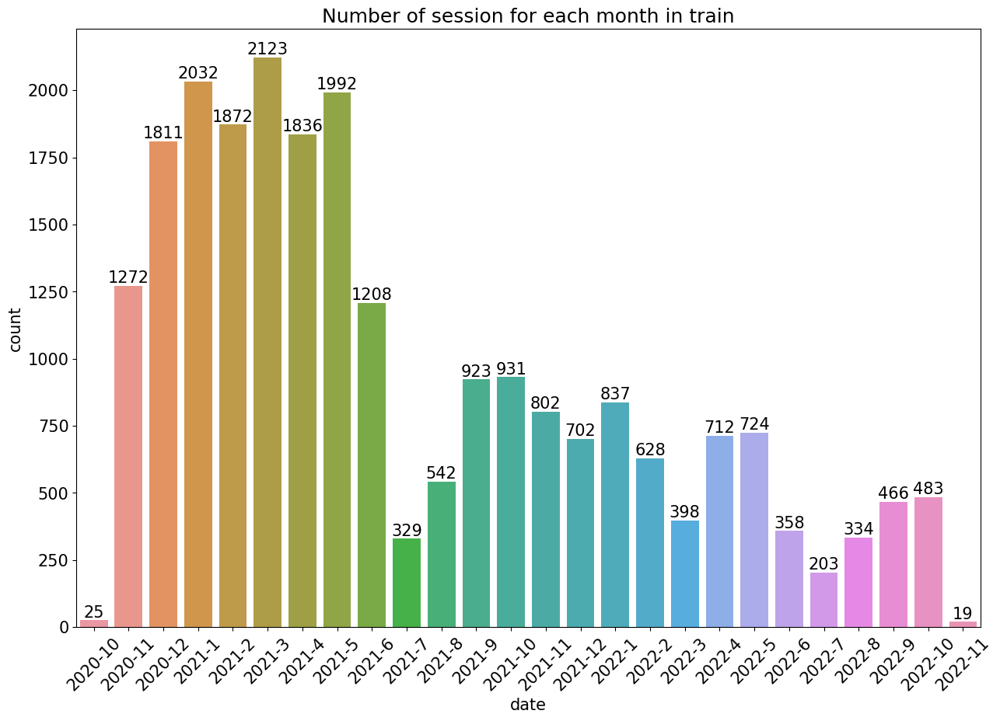

In [205]:
train_session_ids['year'] = train_session_ids['year'] + 2000
train_session_ids['date'] = (train_session_ids['year']).astype(str) + '-' + (train_session_ids['month']).astype(str)
plt.figure(figsize=(15,10))
g = sns.countplot(x='date', data=train_session_ids)
plt.title('Number of session for each month in train', fontsize=18)
g.set_yticklabels(['{}'.format(int(num)) for num in g.get_yticks()])
g.bar_label(g.containers[0])
g.xaxis.set_tick_params(rotation=45)
plt.show()

train 데이터는 2020년 10월 부터 2022년 11월까지의 데이터이다.

/tmp/ipykernel_14/4228127553.py:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_yticklabels(['{}'.format(int(num)) for num in g.get_yticks()])


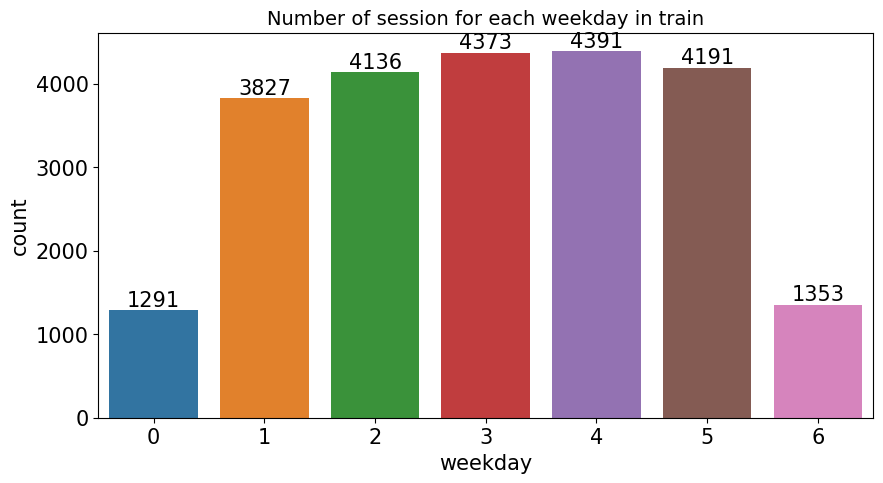

In [206]:
plt.figure(figsize=(10, 5))
g = sns.countplot(x='weekday', data=train_session_ids)
plt.title('Number of session for each weekday in train', fontsize=14)
g.set_yticklabels(['{}'.format(int(num)) for num in g.get_yticks()])
g.bar_label(g.containers[0])
g.xaxis.set_tick_params()
plt.show()

아무래도 7일의 데이터로 순서대로 [일, 월, 화, 수, 목, 금, 토] 인 것 같다. 평일은 학교(또는 직장)에 가서 게임을 하여 빈도가 높고, 주말에는 집에서 쉬느라 빈도가 낮아보인다. 그 증거로는 아래 그래프에도 나타난다.

/tmp/ipykernel_14/2306667624.py:4: UserWarning: FixedFormatter should only be used together with FixedLocator
  g.set_yticklabels(['{}'.format(int(num)) for num in g.get_yticks()])


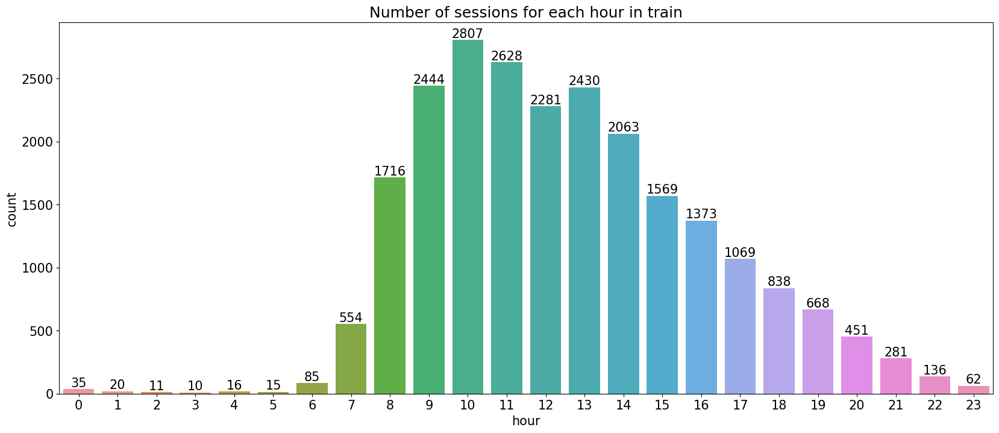

In [207]:
plt.figure(figsize=(20,8))
g = sns.countplot(x='hour', data=train_session_ids)
plt.title('Number of sessions for each hour in train', fontsize=18)
g.set_yticklabels(['{}'.format(int(num)) for num in g.get_yticks()])
g.bar_label(g.containers[0])
g.xaxis.set_tick_params()
plt.show()

시간대를 보면 오전 8시 부터 오후 6시 까지 높은 빈도를 보여준다. 즉 평일 일과시간에 빈도수가 높다는 것을 알 수 있다.

그럼 이제 test데이터를 살펴보자...

In [208]:
test_session_ids

,session_id,year,month,weekday,hour,minute,second,ms,unknown
0,20090109393214576,20,10,1,9,39,32,145,76
1,20090312143683264,20,10,3,12,14,36,832,64
2,20090312331414616,20,10,3,12,33,14,146,16


test 데이터는 2020년 10월 데이터만 존재하고, 월요일 1개, 수요일 2개가 있다.  
train 데이터와 마찬가지로 평일 일과시간의 데이터가 존재한다.

다행히 train 데이터와 test 데이터의 날짜 feature가 다르지 않아 제거하는 일은 없을 것 같다.

### 3. Index

Index는 데이터의 index를 나타내준다. 하지만 session 별 index에도 중복값은 존재했다.

In [209]:
idx = train[['session_id', 'index']]
idx_duple = idx[idx.duplicated()]

print(len(idx_duple))
print(len(idx_duple['session_id'].unique()))
print(idx_duple['session_id'].unique()[:4])

34534
142
[20110422113670820 20110507081078290 20110507133502024 20110507320323120]


train에서 session_id 별 index의 중복값은 총 34534개의 데이터가 나왔다.  
거기에서 session_id의 고윳값은 142개이고 4개를 뽑아보니 [20110422113670820, 20110507081078290, 20110507133502024, 20110507320323120] 등이 존재한다.

In [210]:
train.loc[(train['session_id'] == 20110507081078290) & (train['index'].isin([624, 625]))].sort_values('index')

,session_id,index,elapsed_time,event_name,name,level,page,room_coor_x,room_coor_y,screen_coor_x,screen_coor_y,hover_duration,text,fqid,room_fqid,text_fqid,level_group
3160214,20110507081078290,624,0,cutscene_click,basic,0,NaN,-474.0,34.6875,320.0,300.0,NaN,undefined,intro,tunic.historicalsociety.closet,tunic.historicalsociety.closet.intro,0-4
3160963,20110507081078290,624,1213398,navigate_click,undefined,21,NaN,-424.5,-84.0625,184.0,392.0,NaN,NaN,NaN,tunic.library.frontdesk,NaN,13-22
3160215,20110507081078290,625,1564,person_click,basic,0,NaN,-474.0,35.6875,320.0,299.0,NaN,"Whatcha doing over there, Jo?",gramps,tunic.historicalsociety.closet,tunic.historicalsociety.closet.gramps.intro_0_...,0-4
3160964,20110507081078290,625,1214182,navigate_click,undefined,21,NaN,-580.0,-72.0000,124.0,383.0,NaN,NaN,NaN,tunic.library.frontdesk,NaN,13-22


그러면 train에서 session_id가 20110507081078290이고 index가 624(또는 625)인 데이터들을 추출해보니 2개씩 총 4개의 데이터가 나타났다. 즉 session_id 별 index에도 중복값은 존재하였고,  
더 나아가 어떤 session_id는 index가 0인 값이 없었다.(index == 0은 게임 시작을 알림)

In [211]:
non_zero_index = train.groupby('session_id').filter(lambda x: 0 not in x['index'].values)['session_id'].unique()
print(len(non_zero_index))
print(non_zero_index[:4])

92
[20110422214253730 20110507404587470 20110508095691800 20110508122205864]


index가 0이 없는 session_id는 총 92개 존재한다.  

그렇다면 왜 없는 것일까? Discussion에서 한 질문에 답이 있었다. [What dose 'index' in train.csv actually mean?](https://www.kaggle.com/competitions/predict-student-performance-from-game-play/discussion/384342#2134312)    
결론을 말하자면, 사용자가 너무 빠르게 클릭(시작)을 하여 데이터에 오류가 발생한 것이다. 이 문제를 해결하기위해 [@AbaoJiang](https://www.kaggle.com/abaojiang) 님의 [EDA on Game Progress](https://www.kaggle.com/code/abaojiang/eda-on-game-progress)와 [Dangers in Data](https://www.kaggle.com/competitions/predict-student-performance-from-game-play/discussion/395250) (Discussion)을 참고하였다.

해결은 후에 Features Engineering에서 다뤄보도록 하겠습니다.

### 4. Elapsed_time

Elapsed_time은 session의 시작과 데이터가 기록된 기간(끝) 사이에 발생한 시간들을 보여준다. (단위 : 밀리세컨)

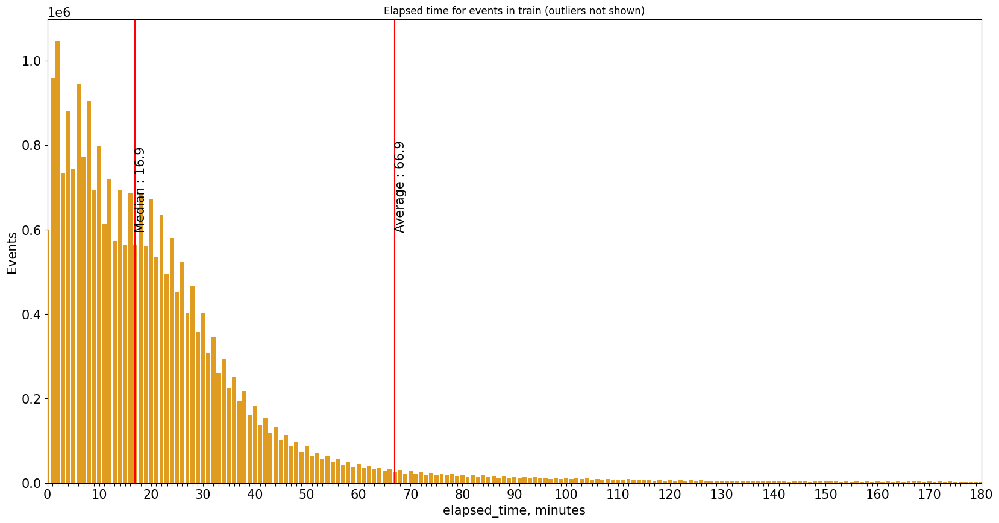

In [212]:
elapsed_time_train = round((train['elapsed_time']).astype(np.float64)/60000, 1) # 60000 밀리세컨드 = 1분
mean_elapsed_time_train = elapsed_time_train.mean()
median_elapsed_time_train = elapsed_time_train.median()
elapsed_time_train_count = round(elapsed_time_train, 0).astype(np.int64).value_counts()

plt.figure(figsize=(20,10))
g = sns.barplot(x=elapsed_time_train_count.index, y=elapsed_time_train_count.values, color='orange')
plt.title('Elapsed time for events in train (outliers not shown)', fontsize=12)
g.set_xticklabels(['{}'.format(int(num)) if i % 10 == 0 else '' for i, num in enumerate(g.get_xticks())])
g.set(xlabel='elapsed_time, minutes', ylabel='Events')
g.axvline(x=mean_elapsed_time_train, color='red')
g.text(mean_elapsed_time_train, 600000, f'Average : {round(mean_elapsed_time_train, 1)}', rotation=90)
g.axvline(x=median_elapsed_time_train, color='red')
g.text(median_elapsed_time_train, 600000, f'Median : {round(median_elapsed_time_train, 1)}', rotation=90)
plt.xlim(0, 180)
plt.show()

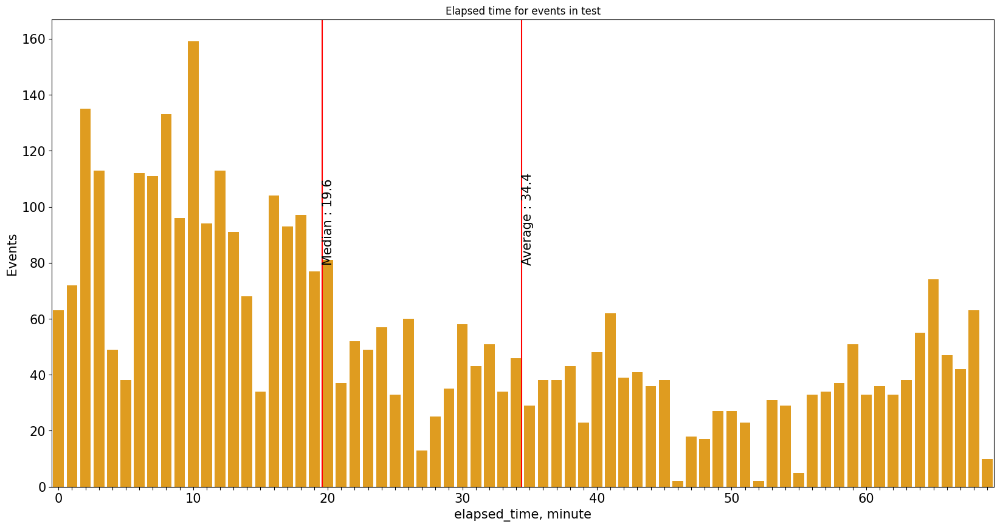

In [213]:
elapsed_time_test = round((test['elapsed_time']).astype(np.float64)/60000, 1)
mean_elapsed_time_test = elapsed_time_test.mean()
median_elapsed_time_test = elapsed_time_test.median()
elapsed_time_test_count = round(elapsed_time_test, 0).astype(np.int64).value_counts()

plt.figure(figsize=(20,10))
g = sns.barplot(x=elapsed_time_test_count.index, y=elapsed_time_test_count.values, color='orange')
plt.title('Elapsed time for events in test', fontsize=12)
g.set_xticklabels(['{}'.format(int(num)) if i % 10 == 0 else '' for i, num in enumerate(g.get_xticks())])
g.set(xlabel='elapsed_time, minute', ylabel='Events')
g.axvline(x=mean_elapsed_time_test, color='red')
g.text(mean_elapsed_time_test, 80, f'Average : {round(mean_elapsed_time_test, 1)}', rotation=90)
g.axvline(x=median_elapsed_time_test, color='red')
g.text(median_elapsed_time_test, 80, f'Median : {round(median_elapsed_time_test, 1)}', rotation=90)
plt.show()

train과 test의 elapsed_time의 빈도수를 나타내는 그래프이다. train을 살펴보면 0~10분 사이의 빈도가 가장 많고, 이후 점점 감소하는 성향을 보여준다.  
그에 반해 test는 모든 elapsed_time이 골고루 퍼져있는 성향을 보여준다.  

그럼 session_id 별 elapsed_time의 최댓값들을 살펴보자.

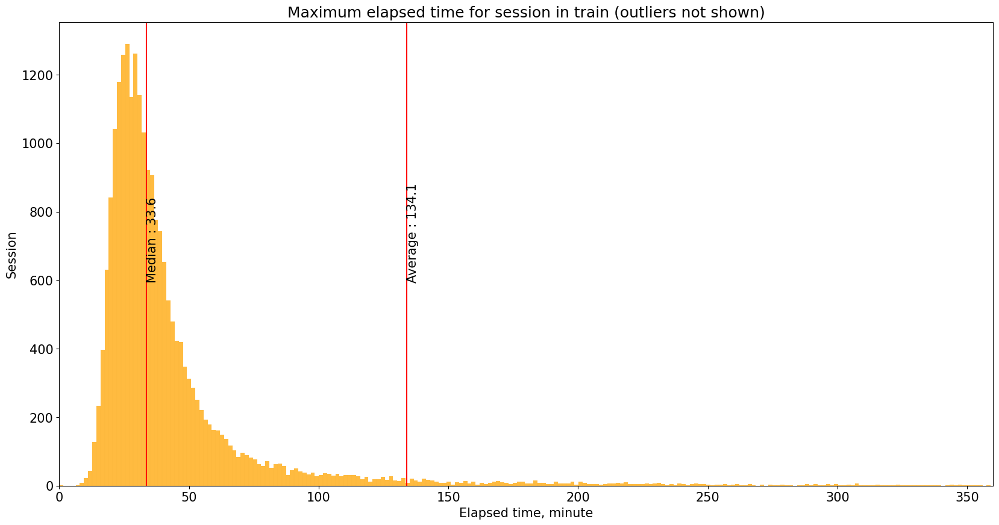

In [214]:
max_elapsed_time = train.groupby('session_id')['elapsed_time'].max()
max_elapsed_time = round(max_elapsed_time / 60000, 1)

mean_elapsed_time = max_elapsed_time.mean()
median_elapsed_time = max_elapsed_time.median()

plt.figure(figsize=(20, 10))
g = sns.histplot(max_elapsed_time, kde=False, color='orange')
plt.title('Maximum elapsed time for session in train (outliers not shown)', fontsize=18)
plt.ticklabel_format(style='plain', axis='x')
g.set(xlabel='Elapsed time, minute', ylabel='Session')
plt.axvline(x=mean_elapsed_time, color='red')
plt.text(mean_elapsed_time, 600, f'Average : {round(mean_elapsed_time, 1)}', rotation=90)
plt.axvline(x=median_elapsed_time, color='red')
plt.text(median_elapsed_time, 600, f'Median : {round(median_elapsed_time, 1)}', rotation=90)
plt.xlim(0, 360)
plt.show()

아무래도 각 session_id 별 elapsed_time의 최댓값의 빈도수를 나타내는데 점점 상승하는 그래프가 그려질줄 알았지만, 예상과는 흘러갔다.  
신기하게도 session_id의 빈도수 그래프와 유사하게 정규분포를 이루고 있고, 양의 왜도(positive skewness)를 띄고 있다.  

In [215]:
train['elapsed_time_change'] = (train.groupby('session_id')['elapsed_time'].diff()).astype(np.float32)

print('elapsed_time의 차이가 음수값을 나타내는 데이터 수 : ',len(train[train['elapsed_time_change'] < 0]))
print('elapsed_time의 차이가 음수값을 나타내는 데이터 비율 : ', round(len(train[train['elapsed_time_change'] < 0]) / len(train) * 100, 2))
print('elapsed_time의 차이가 음수값을 나타내는 session_id 고윳값 개수' ,len(train.loc[train['elapsed_time_change'] < 0, 'session_id'].unique()))
print('elapsed_time의 차이가 음수값을 나타내는 session_id 비율', round(len(train.loc[train['elapsed_time_change'] < 0, 'session_id'].unique()) * 100 / len(train['session_id'].unique()), 2))

elapsed_time의 차이가 음수값을 나타내는 데이터 수 :  654500
elapsed_time의 차이가 음수값을 나타내는 데이터 비율 :  2.49
elapsed_time의 차이가 음수값을 나타내는 session_id 고윳값 개수 23537
elapsed_time의 차이가 음수값을 나타내는 session_id 비율 99.89


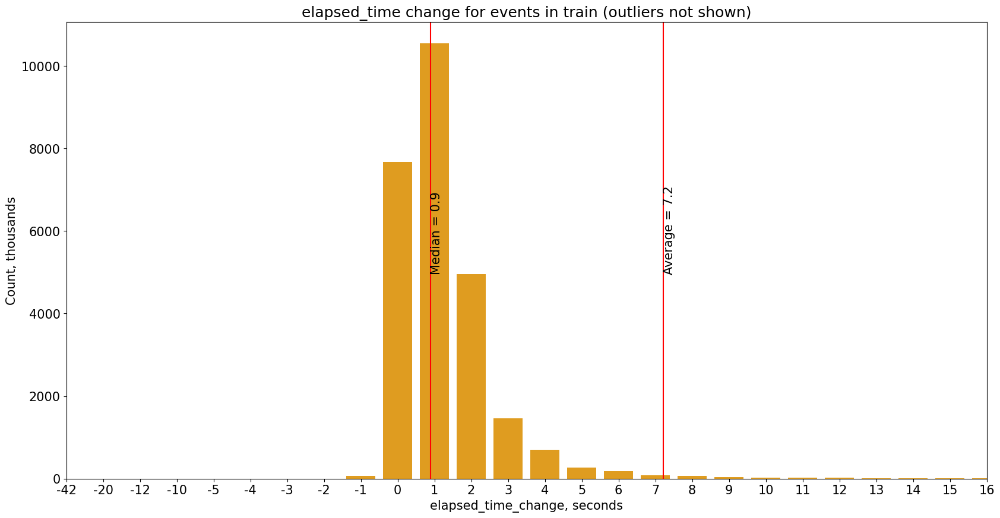

In [216]:
elapsed_time_change = np.round(train[train['elapsed_time_change'].notna()]['elapsed_time_change']/1000.0, 1)
mean_elapsed_time_change = elapsed_time_change.mean()
median_elapsed_time_change = elapsed_time_change.median()
elapsed_time_change_counts = (np.round(elapsed_time_change, 0).astype(np.int64).value_counts()/1000).sort_index()
plt.figure(figsize=(20, 10))
g = sns.barplot(x=elapsed_time_change_counts.index, y=elapsed_time_change_counts.values, color='orange')
plt.title('elapsed_time change for events in train (outliers not shown)', fontsize=18)
g.set(xlabel='elapsed_time_change, seconds', ylabel='Count, thousands')
g.axvline(x=mean_elapsed_time_change+14, color="red")
# 원래 f'Average = {round(mean_elapsed_time_change, 1)}' 이지만 왜 인지 모르게 적용이 되지 않아 값을 직접 집어넣었습니다.
g.text(mean_elapsed_time_change+14, 5000, 'Average = 7.2', rotation=90)
g.axvline(x=median_elapsed_time_change+14, color="red")
# 원래 f'Average = {round(median_elapsed_time_change, 1)}' 이지만 왜 인지 모르게 적용이 되지 않아 값을 직접 집어넣었습니다.
g.text(median_elapsed_time_change+14, 5000, 'Median = 0.9', rotation=90)
plt.xlim(5, 30)
plt.show()

위 그래프는 elapsed_time과이 차이를 나타내는 그래프이다. 그래프를 살펴보면 차이가 -1인 것도 있고, 0과 2이상인 것들로 있는 것으로 보아 elapsed_time이 단조롭게 상승하는(차이가 1) 그래프가 아니라는 것을 알 수 있다. 또한 위에서 언급하였듯이 ([@AbaoJiang](https://www.kaggle.com/abaojiang) 님의 [EDA on Game Progress](https://www.kaggle.com/code/abaojiang/eda-on-game-progress)) 이러한 문제도 있는데, 이 문제가 train 데이터 뿐만 아니라 test 데이터에서도 발견되어([Problems in the Train Data are also present in the Test Data!!! 🙉🙊](https://www.kaggle.com/competitions/predict-student-performance-from-game-play/discussion/395686)) 해결책은 후에 업데이트 해봐야겠다. 

### Event properties(event_name, name, fqid)

- event_name은 데이터 이벤트의 타입을 나타낸다.
- name은 데이터 이벤트의 이름을 나타낸다.
- fqid는 데이터 이벤트의 고유번호를 나타낸다.

In [217]:
event_names_counts_train = train['event_name'].value_counts()/1000
names_counts_train = train['name'].value_counts()/1000
fqid_counts_train = train['fqid'].value_counts()
event_names_counts_test = test['event_name'].value_counts()
names_counts_test = test['name'].value_counts()
fqid_counts_test = test['fqid'].value_counts()

print('event_name 고윳값 : ', len(event_names_counts_train))
print('name 고윳값 : ', len(names_counts_train))
print('fqid 고윳값 : ', len(fqid_counts_train))

event_name 고윳값 :  11
name 고윳값 :  6
fqid 고윳값 :  128


event_name, name, fqid의 고윳값은 상대적으로 적은 값을 보여주고있고, 내용들은 위 고윳값 확인에서 찾아볼 수 있습니다.

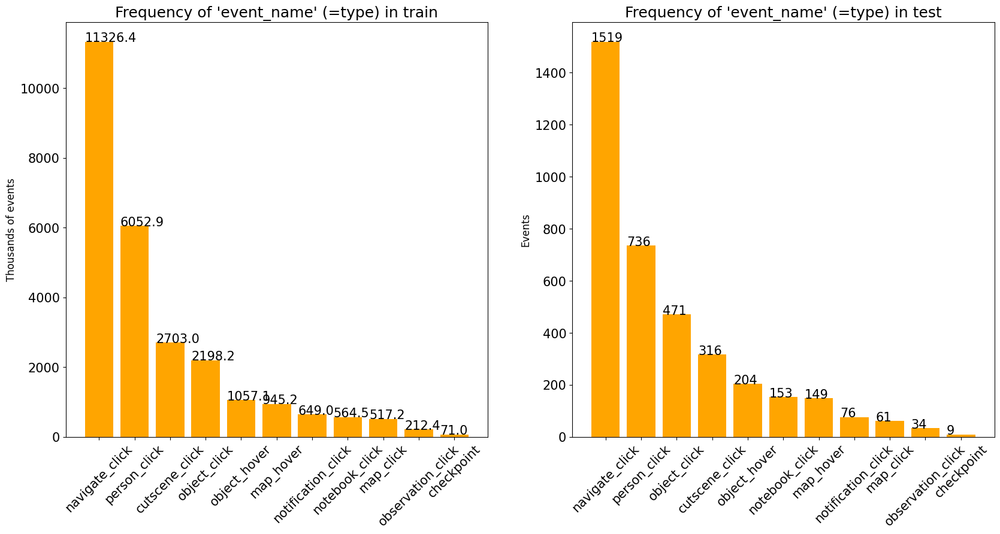

In [218]:
plt.figure(figsize=(20, 9))

plt.subplot(1,2,1)
plt.bar(event_names_counts_train.index, event_names_counts_train.values, color='orange')
plt.ylabel('Thousands of events', fontsize=12)
plt.title("Frequency of 'event_name' (=type) in train", fontsize=18)
for i, v in enumerate(event_names_counts_train.values):
    plt.text(i-0.4, v, str(round(v, 1)))
plt.xticks(rotation=45)

plt.subplot(1,2,2)
plt.bar(event_names_counts_test.index, event_names_counts_test.values, color='orange')
plt.ylabel('Events', fontsize=12)
plt.title("Frequency of 'event_name' (=type) in test", fontsize=18)
for i, v in enumerate(event_names_counts_test.values):
    plt.text(i-0.4, v, str(round(v, 1)))
plt.xticks(rotation=45)
plt.show()

train 데이터와 test 데이터의 event_names 빈도 수를 그래프로 그려보았다. 다행이도 train과 test의 그래프는 비슷한 모습을 보여주고있다. event_name의 각 의미는...

- navigate_click : 주인공을 움직이기 위해 어떤 장소를 클릭
- person_click : 사람 클릭
- custcene_click : 컷씬 클릭
- object_click : 물체를 클릭(오직 notification_click 이후)
- object_hover : 학생이 물체 위에 마우스 포인터를 올림
- map_hover : 학생이 지도 위에 마우스 포인터를 올림
- notification_click : navigate_click 후, 편지나 어떤 통지문 클릭(편지가 화면에 나타나거나, 사라지거나 함)
- notebook_click : 노트북을 클릭
- map_click : 이동을 위해 지도에 이동장소를 클릭
- observation_click : 마우스 포인터를 갖다 대면, 검은색으로 나타나는 물체 클릭
- checkpoint : level_group 또는 chapter의 마지막

당연하듯이 주인공을 움직이는 navigate_click이 가장 많고, 그 다음으로 사람을 클릭하는 person_click이 많다.

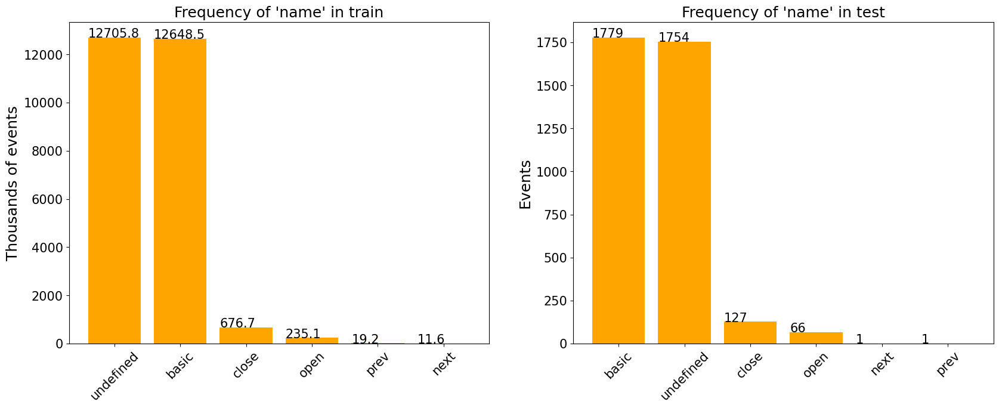

In [219]:
plt.figure(figsize=(20,7))

plt.subplot(1,2,1)
plt.bar(names_counts_train.index, names_counts_train.values, color='orange')
plt.ylabel('Thousands of events', fontsize=18)
plt.title("Frequency of 'name' in train", fontsize=18)
for i, v in enumerate(names_counts_train):
    plt.text(i-0.4, v, str(round(v, 1)))
plt.xticks(rotation=45)

plt.subplot(1,2,2)
plt.bar(names_counts_test.index, names_counts_test.values, color='orange')
plt.ylabel('Events', fontsize=18)
plt.title("Frequency of 'name' in test", fontsize=18)
for i, v in enumerate(names_counts_test):
    plt.text(i-0.4, v, str(round(v, 1)))
plt.xticks(rotation=45)
plt.show()

event_name과 마찬가지로 name의 그래프 모습도 train과 test의 데이터는 비슷하다. 그래프를 살펴보면 undefined와 basic이 가장 많지만 의미는 아직 잘 모르겠다.  
다음으로는 event_name과 name의 빈도수를 알아보자.

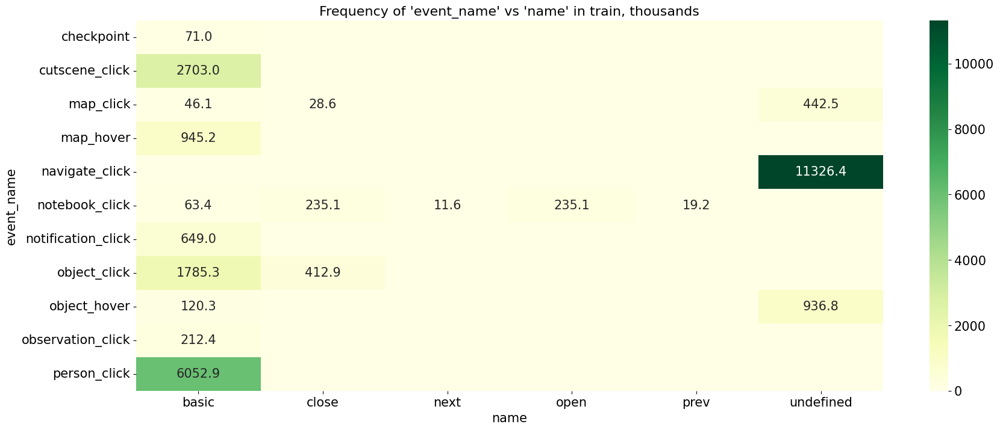

In [220]:
pivot = train.pivot_table(index='event_name', columns='name', aggfunc='size') # aggfunc='size' : 그룹갯수 (='count')
pivot = (pivot.fillna(0) / 1000).round(decimals=1)
plt.figure(figsize=(20,8))
annotations = pivot.astype(str)
annotations[pivot == 0] = ''
g = sns.heatmap(pivot, annot=annotations, fmt='', cmap='YlGn')
plt.title("Frequency of 'event_name' vs 'name' in train, thousands", fontsize=16)
plt.show()

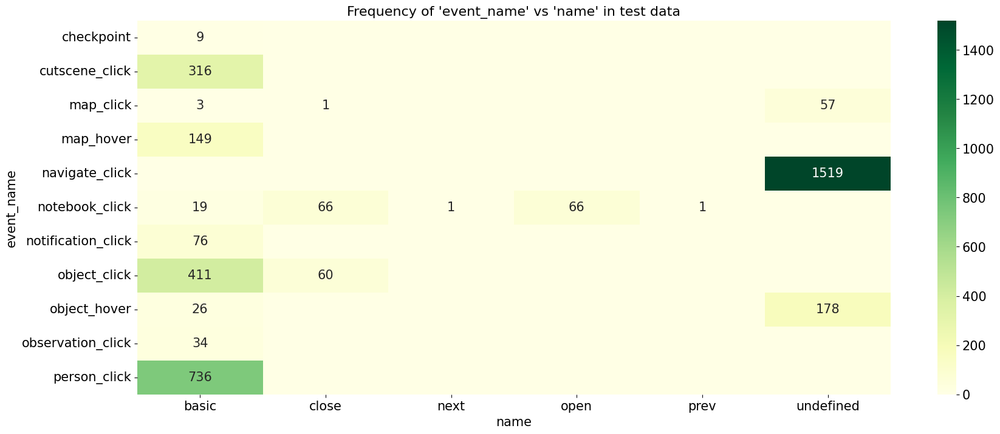

In [221]:
pivot = test.pivot_table(index='event_name', columns='name', aggfunc='size')
pivot = pivot.fillna(0).astype(int)
plt.figure(figsize=(20,8))
annotations = pivot.astype(str)
annotations[pivot == 0] = ''
g = sns.heatmap(pivot, annot=annotations, fmt='', cmap='YlGn')
plt.title("Frequency of 'event_name' vs 'name' in test data", fontsize=16)
plt.show()

train과 test의 event_name 과 name의 빈도 수를 살펴보면 두 빈도 역시 비슷한 모습을 보여주고 있고, event_name에서 가장 많은 빈도를 나타낸 naviage_click이 name의 undefined에 전부 있는 것을 알 수 있고, 그 다음으로 많았던 person_click은 basic에 전부 있는 것을 알 수 있습니다.

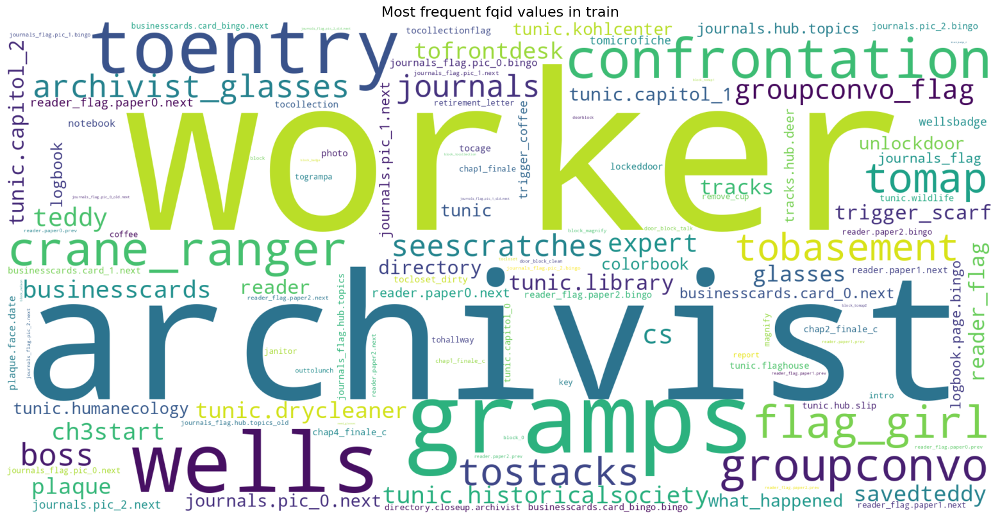

In [222]:
word_freq_train = dict(zip(fqid_counts_train.index.tolist(), fqid_counts_train.values.tolist()))
wordcloud_train = WordCloud(width=2000, height=1000, background_color='white').generate_from_frequencies(word_freq_train)
plt.figure(figsize=(20,10))
plt.imshow(wordcloud_train, interpolation='bilinear') 
# interpolation은 보간법을 뜻하며, 픽셀들의 축 위치 간격을 보정하여 이미지가 자연스러운 모양으로 보일 수 있게 하는 방법
# bilinear은 경계선들을 흐리게 보여준다.
plt.title('Most frequent fqid values in train', fontsize=16)
plt.axis('off')
plt.show()

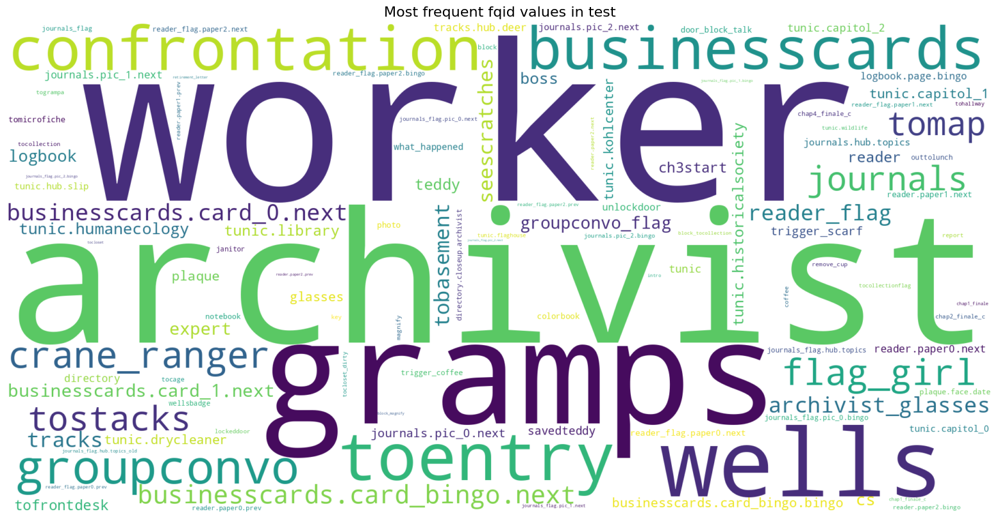

In [223]:
word_freq_test = dict(zip(fqid_counts_test.index.tolist(), fqid_counts_test.values.tolist()))
wordcloud_test = WordCloud(width=2000, height=1000, background_color='white').generate_from_frequencies(word_freq_test)
plt.figure(figsize=(20,10))
plt.imshow(wordcloud_test, interpolation='bilinear')
plt.title('Most frequent fqid values in test', fontsize=16)
plt.axis('off')
plt.show()

In [224]:
print('TOP 20 fqid 고윳값')
stat = pd.DataFrame([fqid_counts_train, fqid_counts_test]).T
stat.columns = ['train', 'test']
stat = stat.sort_values('train', ascending=False)
stat.head(20).style.format(precision=0) # style.format(percision=) 은 정확도(소수점)을 나타낸다.

TOP 20 fqid 고윳값


,train,test
worker,1878958,214
archivist,1127341,148
gramps,1122264,144
wells,787418,102
toentry,784496,94
confrontation,697098,78
crane_ranger,503927,54
groupconvo,455705,55
flag_girl,449742,53
tomap,403048,44


fqid의 고윳값들을 살펴보면 worker라는 단어가 제일 많고, 그 다음으로는 archivist, gramps ... 순으로 많다.  
만약 fqid를 학습에 적용할려면 순서대로 원-핫 인코딩을 하거나, 순서대로 0 ~ 129까지 인코딩을 하고, 0 ~ 1로 feature scaling을 하면 될 거 같다.

### Room_fqid

room_fqid는 각 방의 고유번호를 나타낸다. 

In [225]:
room_counts_train = train['room_fqid'].value_counts()/1000
room_counts_test = test['room_fqid'].value_counts()

print('train 데이터의 room_fqid 고윳값 개수 : ', len(room_counts_train))
print('test 데이터의 room_fqid 고윳값 개수 : ', len(room_counts_test))

train 데이터의 room_fqid 고윳값 개수 :  19
test 데이터의 room_fqid 고윳값 개수 :  19


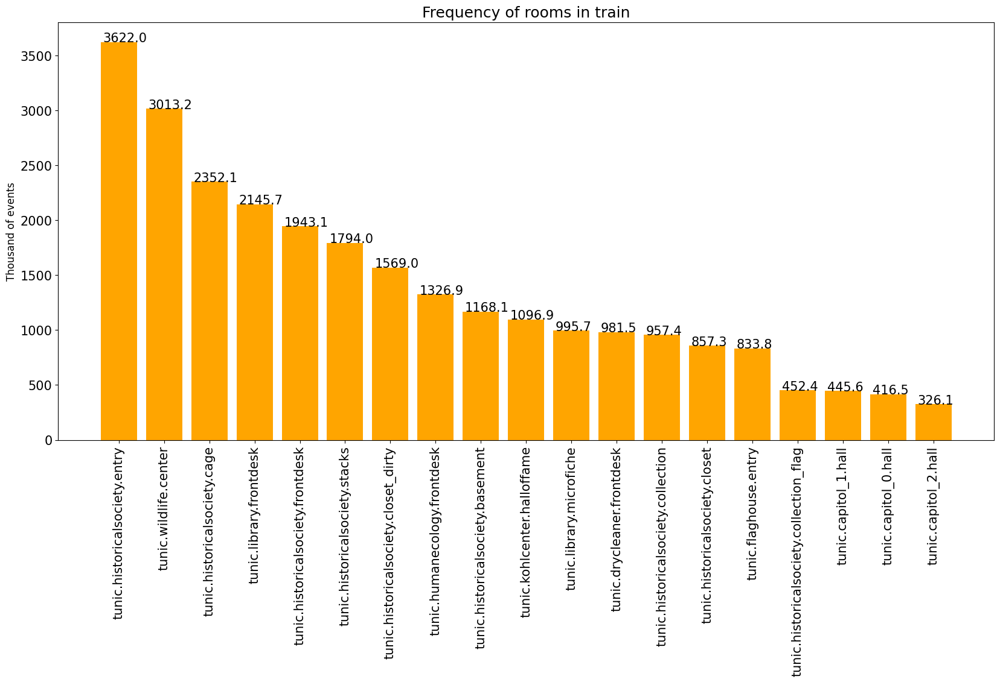

In [226]:
plt.figure(figsize=(20,9))
plt.bar(room_counts_train.index, room_counts_train.values, color='orange')
plt.ylabel('Thousand of events', fontsize=12)
plt.title('Frequency of rooms in train', fontsize=18)
for i, v in enumerate(room_counts_train):
    plt.text(i-0.35, v, str(round(v, 1)))
plt.xticks(rotation=90)
plt.show()

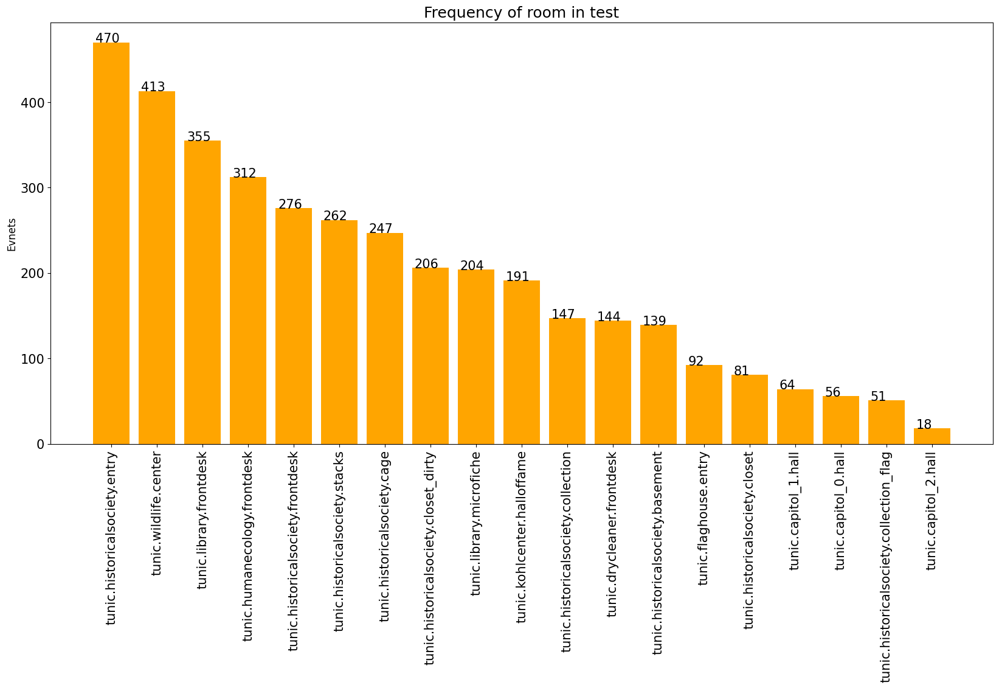

In [227]:
plt.figure(figsize=(20,9))
plt.bar(room_counts_test.index, room_counts_test.values, color='orange')
plt.ylabel('Evnets', fontsize=12)
plt.title('Frequency of room in test', fontsize=18)
for i, v in enumerate(room_counts_test):
    plt.text(i-0.35, v, str(int(v)))
plt.xticks(rotation=90)
plt.show()

room_fqid 들의 빈도 수를 나타내보았다. 여기서 '.'을 기준으로 1번째인 tunic은 모두 포함되어 있어 제거하고, 나머지 2번째와 3번째를 추출하여 그래프를 나타내보록 하겠다.

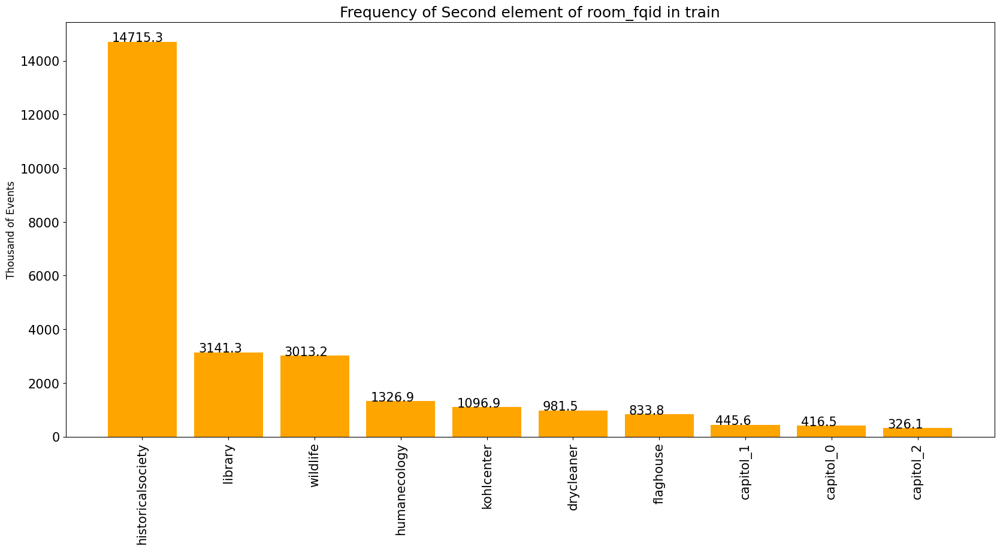

In [228]:
room_fqid_2 = train['room_fqid'].apply(lambda x: x.split('.')[1])
room_fqid_2 = room_fqid_2.value_counts()/1000

plt.figure(figsize=(20,9))
plt.bar(room_fqid_2.index, room_fqid_2.values, color='orange')
plt.ylabel('Thousand of Events', fontsize=12)
plt.title('Frequency of Second element of room_fqid in train', fontsize=18)
for i, v in enumerate(room_fqid_2):
    plt.text(i-0.35, v, str(round(v, 1)))
plt.xticks(rotation=90)
plt.show()

먼저 room_fqid에서 두 번째 원소들의 빈도수를 나타내보았다. 제일 많은 것은 historicalsociety이고 그 외는 비슷했다.

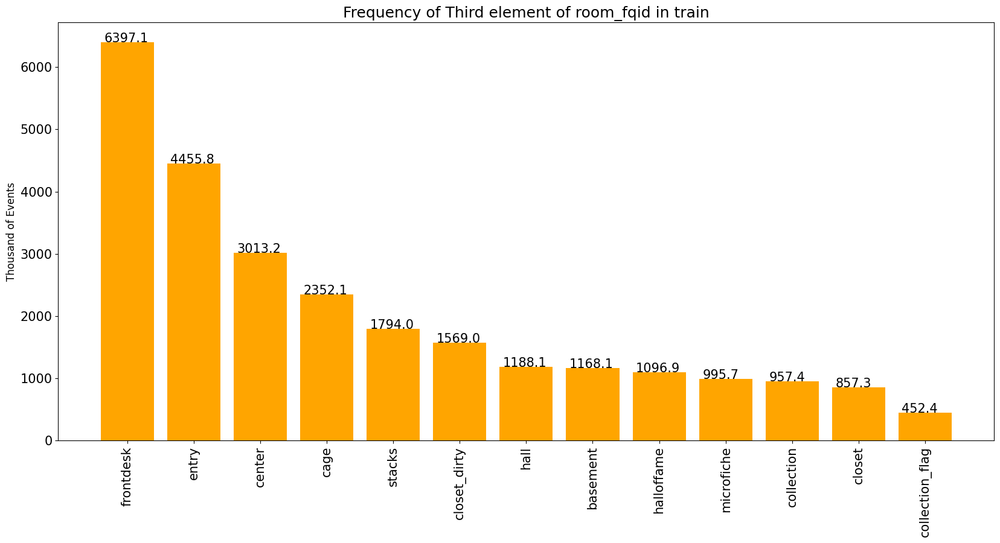

In [229]:
room_fqid_3 = train['room_fqid'].apply(lambda x: x.split('.')[2])
room_fqid_3 = room_fqid_3.value_counts()/1000

plt.figure(figsize=(20,9))
plt.bar(room_fqid_3.index, room_fqid_3.values, color='orange')
plt.ylabel('Thousand of Events', fontsize=12)
plt.title('Frequency of Third element of room_fqid in train', fontsize=18)
for i, v in enumerate(room_fqid_3):
    plt.text(i-0.35, v, str(round(v, 1)))
plt.xticks(rotation=90)
plt.show()

foom_fqid의 세 번째 원소들의 빈도수는 frontdesk가 가장 많았고, 그 뒤로 entry, center 등등 순차적으로 내려갔다.

### Level, Level_group

- level은 이벤트의 난이도입니다. (0부터 22까지 있습니다.)
- level_group은 level의 그룹이자, 질문번호의 그룹입니다. (0-4, 5-12, 13-22)

level_group과 질문 번호는 다음과 같이 작용합니다.

|level_group|questions|number of questions|
|:---:|:---:|:---:|
|0-4|q1 - q3|3|
|5-12|q4 - q13|10|
|13-22|q14 - q18|5|

  
더불어 level이 4, 12, 22 일 때, 질문을 받고 체크포인트가 활성화됩니다.

In [230]:
unique_levels_per_session = train[['session_id', 'level']].drop_duplicates()
missing_sessions = unique_levels_per_session.groupby('session_id').count().reset_index(drop=False)
missing_sessions = missing_sessions[missing_sessions['level'] != 23].reset_index(drop=True)['session_id']
print(f'레벨이 22개가 아닌 session_id : {len(missing_sessions)}')


for lvl in range(22):
    x = unique_levels_per_session.loc[(unique_levels_per_session['session_id'].isin(missing_sessions)) & (unique_levels_per_session['level'] == lvl)]
    if len(x) != len(missing_sessions):
        print(f'{lvl} 레벨이 없는 session 수 : {len(x)}')
        print(f'{lvl} 레벨이 없는 session 5개 :', x['session_id'].to_list()[:5], '\n')

레벨이 22개가 아닌 session_id : 577
7 레벨이 없는 session 수 : 576
7 레벨이 없는 session 5개 : [20090316190523732, 20100007445515820, 20100014211946468, 20100018421509572, 20100020122406090] 

15 레벨이 없는 session 수 : 17
15 레벨이 없는 session 5개 : [20100020122406090, 20100110093663916, 20100309472366890, 20100512192183730, 20110410570739092] 

20 레벨이 없는 session 수 : 561
20 레벨이 없는 session 5개 : [20090316190523732, 20100007445515820, 20100014211946468, 20100018421509572, 20100115005512812] 

21 레벨이 없는 session 수 : 570
21 레벨이 없는 session 5개 : [20090316190523732, 20100007445515820, 20100014211946468, 20100018421509572, 20100020122406090] 



레벨이 22개가 아닌 session_id들도 발견했습니다. 아마 기록상 오류인 것 같습니다.

In [231]:
level_counts_train = train['level'].value_counts()/1000
level_group_counts_train = train['level_group'].value_counts()/1000
level_counts_test = test['level'].value_counts()
level_group_counts_test = test['level_group'].value_counts()

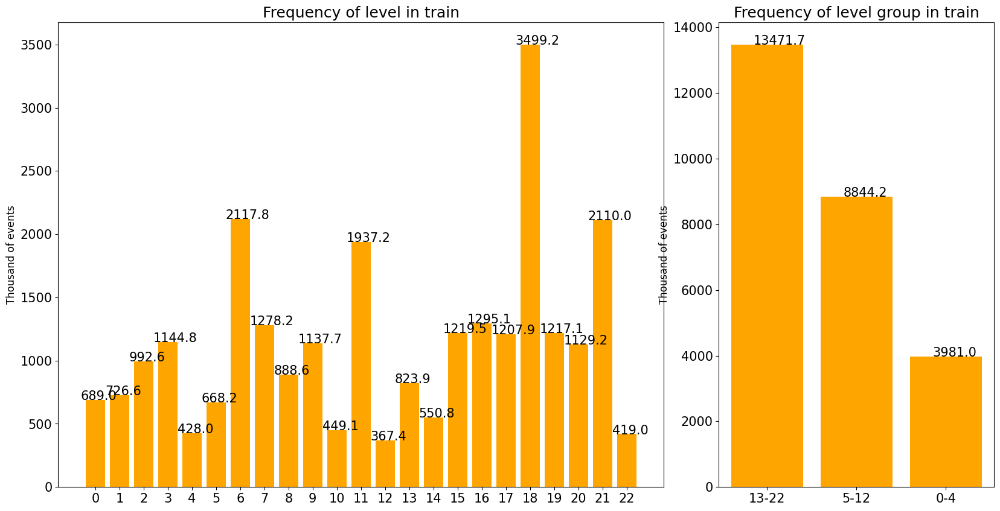

In [232]:
plt.figure(figsize=(20, 10))
plt.subplot(1, 3, (1, 2))
plt.bar(level_counts_train.index, level_counts_train.values, color='orange')
plt.ylabel('Thousand of events', fontsize=12)
plt.title('Frequency of level in train', fontsize=18)
for i, v in enumerate(level_counts_train.sort_index().values):
    plt.text(i-0.6, v, str(round(v, 1)))
plt.xticks(level_counts_train.index)

plt.subplot(1, 3, 3)
plt.bar(level_group_counts_train.index, level_group_counts_train.values, color='orange')
plt.ylabel('Thousand of events', fontsize=12)
plt.title('Frequency of level group in train', fontsize=18)
for i, v in enumerate(level_group_counts_train):
    plt.text(i-0.15, v, str(round(v, 1)))
plt.xticks()
plt.show()

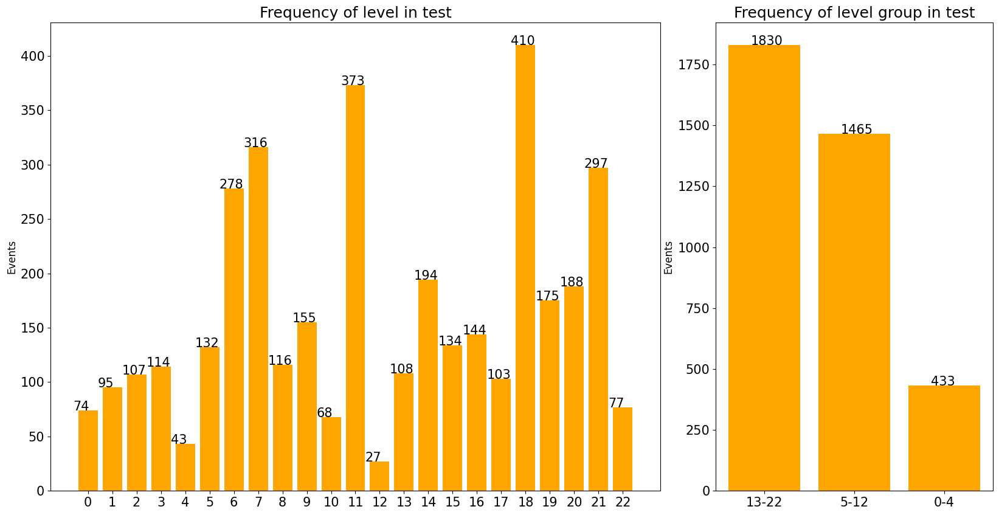

In [233]:
plt.figure(figsize=(20,10))
plt.subplot(1, 3, (1, 2))
plt.bar(level_counts_test.index, level_counts_test.values, color='orange')
plt.ylabel('Events', fontsize=12)
plt.title('Frequency of level in test', fontsize=18)
for i, v in enumerate(level_counts_test.sort_index().values):
    plt.text(i-0.6, v, str(int(v)))
plt.xticks(level_counts_test.index)

plt.subplot(1, 3, 3)
plt.bar(level_group_counts_test.index, level_group_counts_test.values, color='orange')
plt.ylabel('Events', fontsize=12)
plt.title('Frequency of level group in test', fontsize=18)
for i, v in enumerate(level_group_counts_test):
    plt.text(i-0.15, v, str(int(v)))
plt.xticks()
plt.show()

4번과 12번의 빈도가 가장 낮고, trian에서는 18번이 압도적으로 많다면, test에서는 18, 11, 7, 6 순으로 적어진다.

train과 test 데이터에서의 level, level_group의 빈도를 알아보았다. 비율은 비슷하나 test에서 7번과 11번, 14번의 비율이 train과는 다른 모습을 보여준다.

이렇듯 그래프는 이쁘게 나왔지만 두 그래프가 나타내는 정보는 level로 같다. 그래서 후에 Feature engineering을 할 때는 둘 중 하나를 선택해야한다(level 선택).

이제 다른 피처들과 level관의 관계를 알아보자.

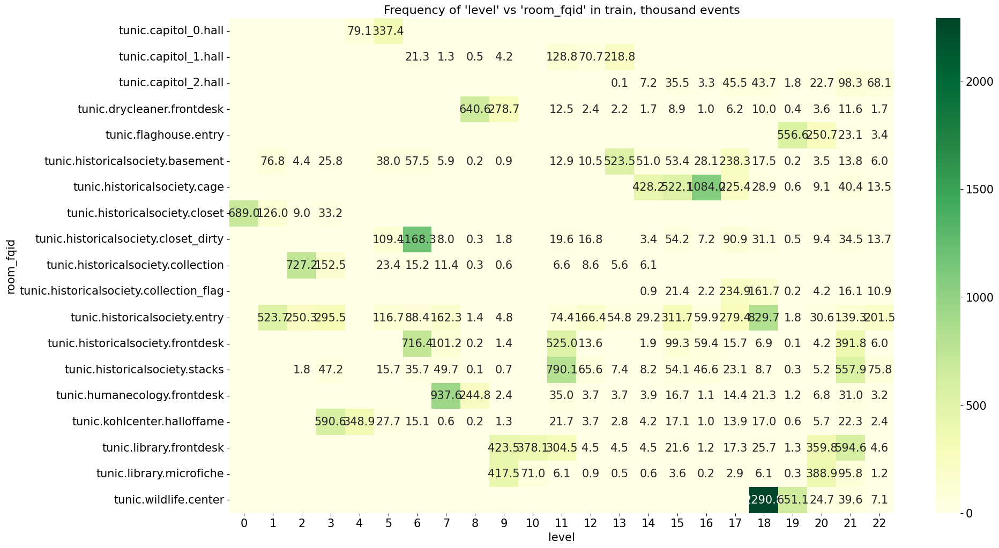

In [234]:
pivot = train.pivot_table(index='room_fqid', columns='level', aggfunc='size')
pivot = (pivot.fillna(0) / 1000).round(decimals=1)
plt.figure(figsize=(20,12))
annotations = pivot.astype(str)
annotations[pivot == 0] = ''
g = sns.heatmap(pivot, annot=annotations, fmt='', cmap='YlGn')
plt.title("Frequency of 'level' vs 'room_fqid' in train, thousand events", fontsize=16)
plt.show()

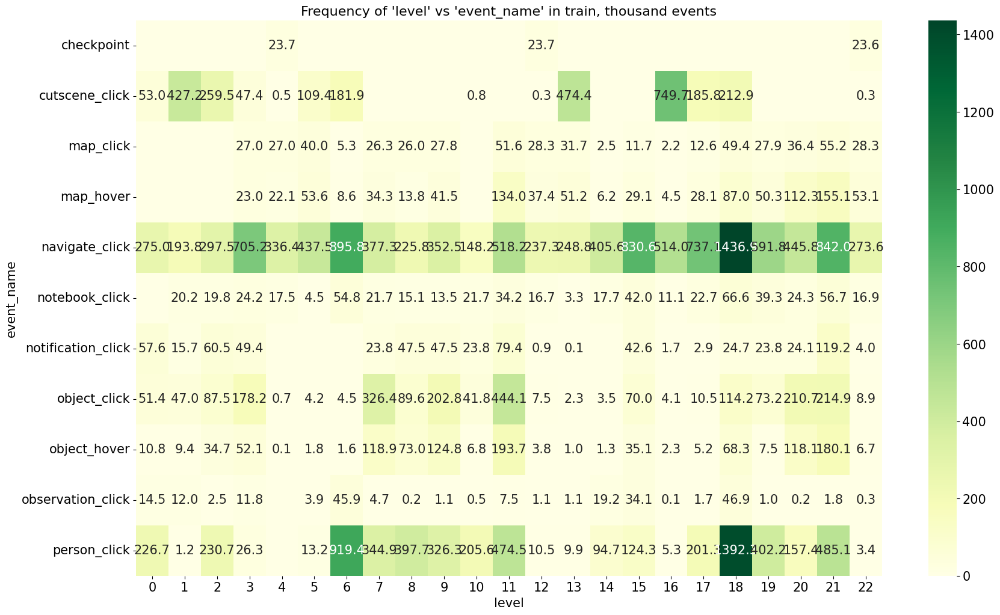

In [235]:
pivot = train.pivot_table(index='event_name', columns='level', aggfunc='size')
pivot = (pivot.fillna(0) / 1000).round(decimals=1)
plt.figure(figsize=(20,12))
annotations = pivot.astype(str)
annotations[pivot == 0] = ''
g = sns.heatmap(pivot, annot=annotations, fmt='', cmap='YlGn')
plt.title("Frequency of 'level' vs 'event_name' in train, thousand events", fontsize=16)
plt.show()

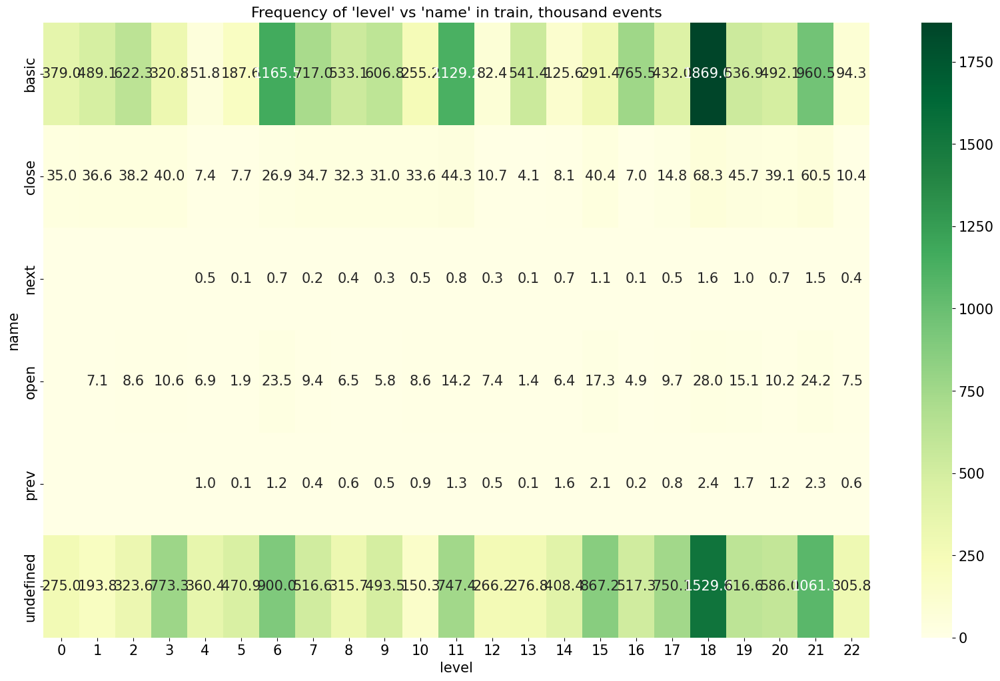

In [236]:
pivot = train.pivot_table(index='name', columns='level', aggfunc='size')
pivot = (pivot.fillna(0) / 1000).round(decimals=1)
plt.figure(figsize=(20,12))
annotations = pivot.astype(str)
annotations[pivot == 0] = ''
g = sns.heatmap(pivot, annot=annotations, fmt='', cmap='YlGn')
plt.title("Frequency of 'level' vs 'name' in train, thousand events", fontsize=16)
plt.show()

### Geo_location
4개의 좌표에 관한 내용입니다.
- room_coor_x : 게임 내에서 방에서 클릭 좌표 (x)
- room_coor_y : 게임 내에서 방에서 클릭 좌표 (y)  

room_coor은 게임의 전체 화면에 관련된 좌표이고, 

- screen_coor_x : 플레이어 화면을 클릭 (x) 
- screen_coor_y : 플레이어 화면을 클릭 (y)

screen_coor은 지금 보여지고 있는 게임 화면에 관련된 좌표입니다.

위 4개는 모두 클릭을 해야하는 상황에서만 기록되었지만, 게임의 90~92%는 모두 클릭해야하는 상황입니다.

In [237]:
print('train에서의 geo_location 비율 : ', round(train['room_coor_x'].count() / len(train) * 100, 2))
print('test에서의 geo_location 비율 : ', round(test['room_coor_x'].count() / len(test) * 100, 2))

train에서의 geo_location 비율 :  92.12
test에서의 geo_location 비율 :  90.29


우선 좌표에 대한 통계량들을 살펴보자!

In [238]:
stat = pd.DataFrame([train['room_coor_x'].describe().index.to_list(), 
                     train['room_coor_x'].astype('float64').describe().values,
                     train['room_coor_y'].astype('float64').describe().values,
                     train['screen_coor_x'].astype('float64').describe().values,
                     train['screen_coor_y'].astype('float64').describe().values,
                     test['room_coor_x'].astype('float64').describe().values,
                     test['room_coor_y'].astype('float64').describe().values,
                     test['screen_coor_x'].astype('float64').describe().values,
                     test['screen_coor_y'].astype('float64').describe().values]).T

stat.columns = [' ', 'room_coor_x in train', 'room_coor_y in train', 
                'screen_coor_x in train', 'screen_coor_y in train',
                'room_coor_x in test', 'room_coor_y in test', 'screen_coor_x in test',
                'screen_coor_y in test']

stat[stat.columns.to_list()[1:]] = stat[stat.columns.to_list()[1:]].apply(pd.to_numeric, errors='coerce')
print('좌표계 통계량 : ')
stat[1:].style.hide_index().format(precision=1).background_gradient(cmap='YlGn')

좌표계 통계량 : 


/tmp/ipykernel_14/2454552126.py:18: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  stat[1:].style.hide_index().format(precision=1).background_gradient(cmap='YlGn')


,room_coor_x in train,room_coor_y in train,screen_coor_x in train,screen_coor_y in train,room_coor_x in test,room_coor_y in test,screen_coor_x in test,screen_coor_y in test
mean,-54.9,-116.2,458.4,385.6,-14.7,-131.1,463.7,394.4
std,520.3,218.5,247.9,129.8,511.1,224.0,243.7,133.5
min,-1992.0,-918.0,0.0,0.0,-1913.0,-908.5,0.0,10.0
25%,-352.8,-212.8,269.0,304.0,-290.1,-232.8,278.2,320.2
50%,-11.2,-97.6,447.0,397.0,16.8,-109.0,460.0,408.0
75%,296.8,22.7,663.0,471.0,355.0,1.0,680.0,486.0
max,1262.0,543.5,1919.0,1440.0,1215.0,489.5,879.0,658.0


하지만 통계량만 본다면 좌표들이 정확히 어떤 것인지를 알 수가 없습니다. 그래서 좌표들로 그래프를 그려 밀집도를 시각화해보겠습니다.

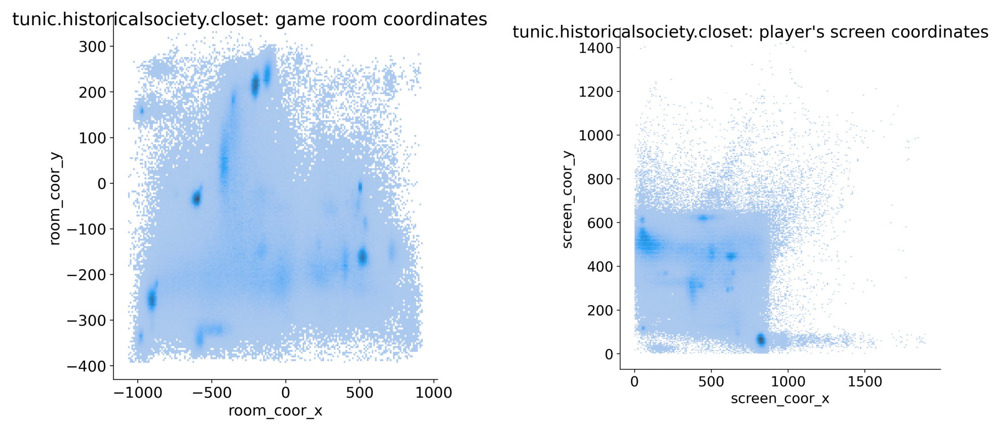

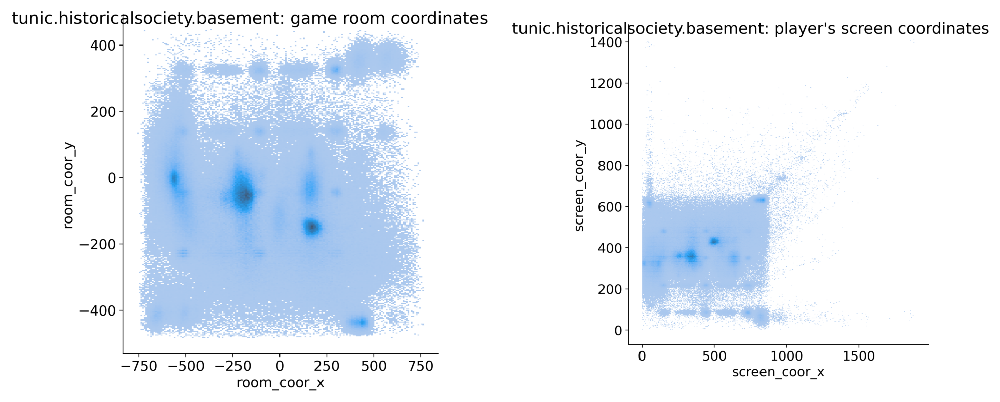

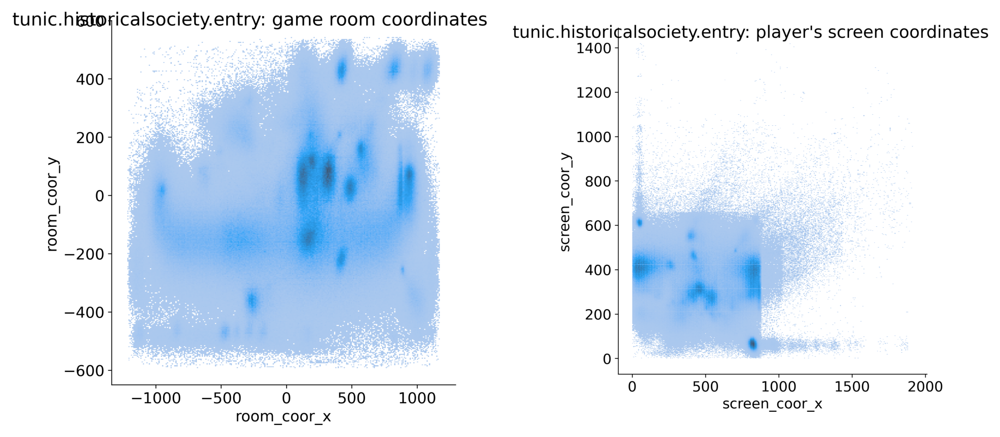

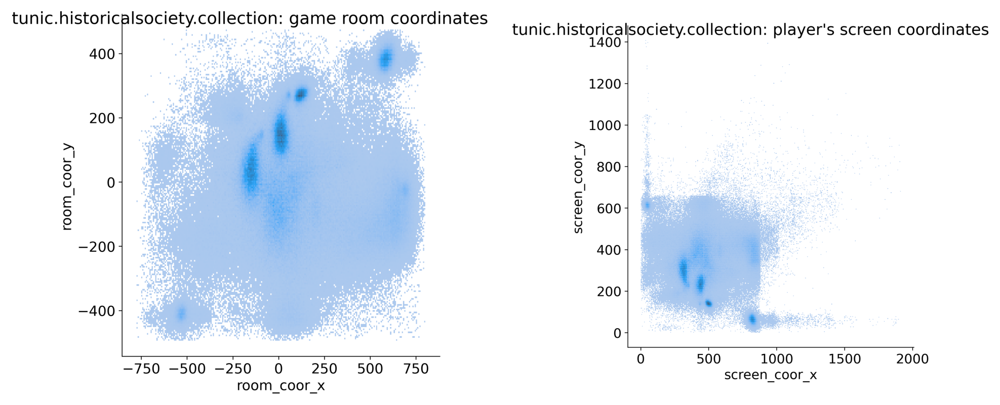

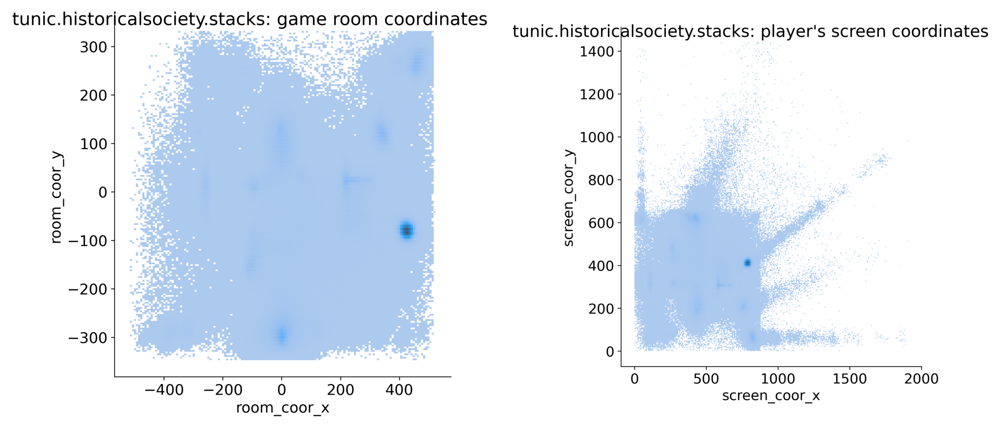

...

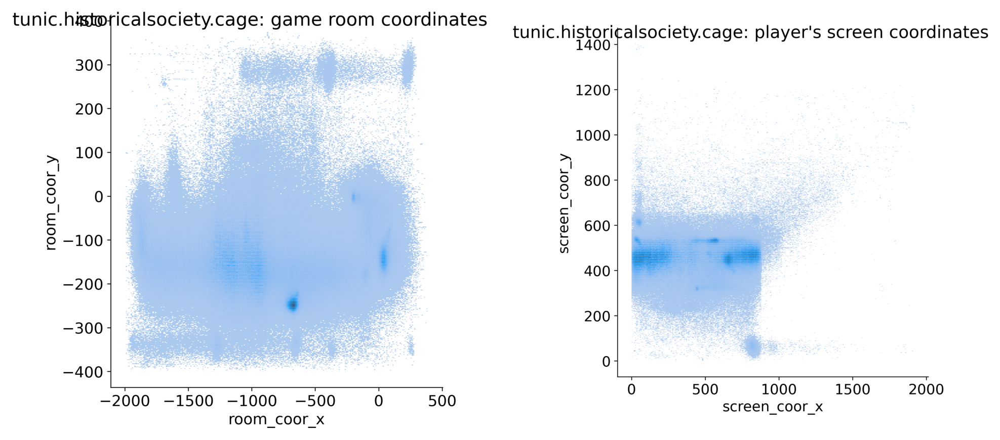

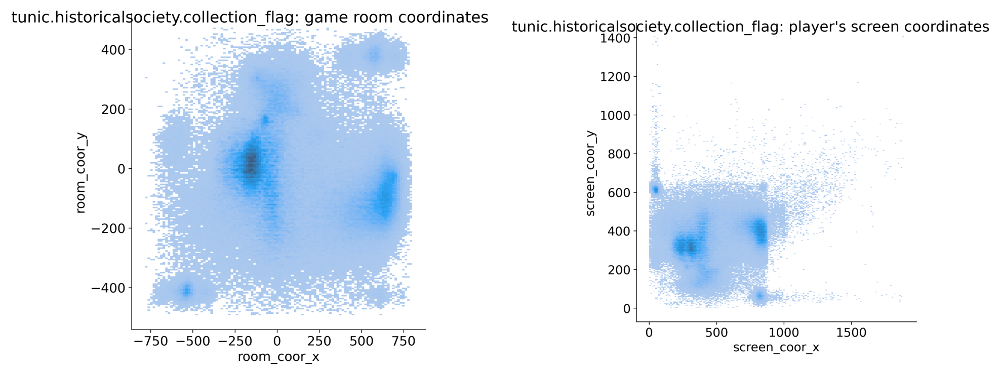

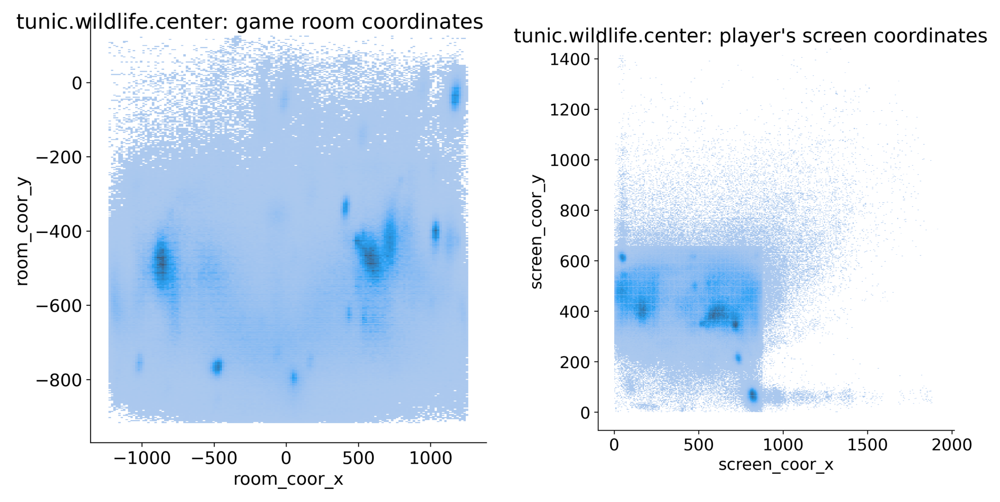

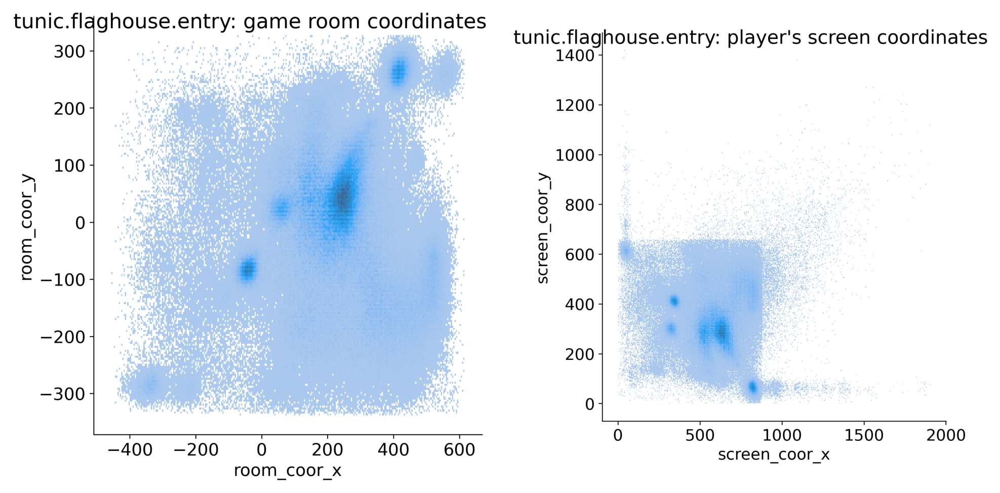

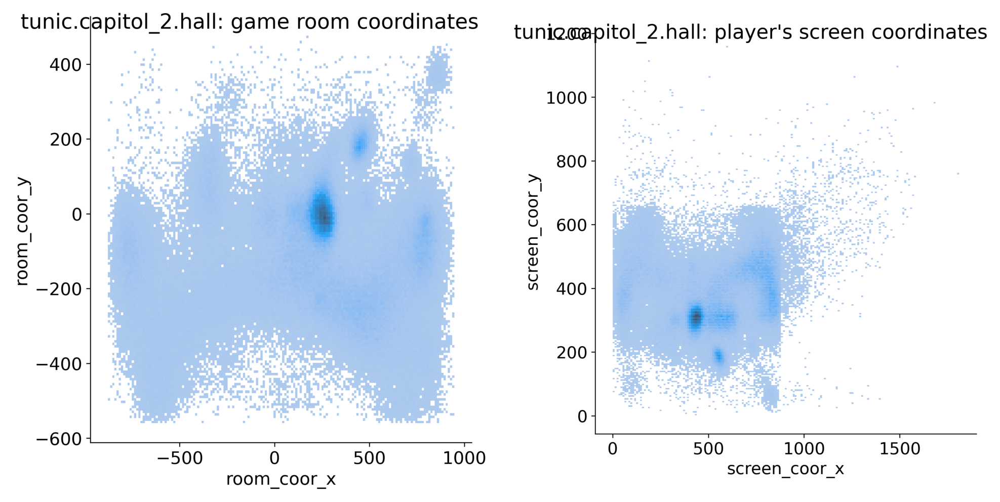

In [239]:
rooms = train['room_fqid'].unique().to_list()
for room in rooms:
    data_room = train[train['room_fqid'] == room]
    data_room = data_room[['room_coor_x', 'room_coor_y', 'screen_coor_x', 'screen_coor_y']].dropna().reset_index(drop=True)
    data_room = data_room.apply(pd.to_numeric, errors='coerce')
    g = sns.pairplot( 
        data = data_room,
        x_vars=['room_coor_x'],
        y_vars=['room_coor_y'],
        kind='hist',
        height=6
    )
    g.fig.suptitle(f'{room}: game room coordinates')
    g.savefig('g0.png', dpi=300)
    plt.close(g.fig)
    
    g = sns.pairplot(
        data=data_room,
        x_vars=['screen_coor_x'],
        y_vars=['screen_coor_y'],
        kind='hist',
        height=6
    )
    g.fig.suptitle(f"{room}: player's screen coordinates")
    g.savefig('g1.png', dpi=300)
    plt.close(g.fig)
    
    f, ax = plt.subplots(1, 2, figsize=(20,20))
    ax[0].imshow(img.imread('g0.png'))
    ax[1].imshow(img.imread('g1.png'))
    [axarr.set_axis_off() for axarr in ax.ravel()]
    plt.tight_layout()
    plt.show()

이로써 색이 진한 파란색으로 나타나는 곳이 높은 밀집도를 가졌다고 볼 수 있습니다. 그리하여 중요한 물체나 특징의 위치를 파악하였습니다. 다음으로는 session_id를 랜덤으로 몇 개만 추출하여 그 session_id의 좌표 움직임을 살펴보겠습니다.

In [240]:
def plot_geo_location(df, session_id):
    session_df = df[df['session_id'] == session_id]
    rooms = session_df['room_fqid'].unique().to_list()
    for room in rooms:
        session_df_room = session_df[session_df['room_fqid'] == room]
        session_df_room = session_df_room[['room_coor_x', 'room_coor_y', 'screen_coor_x', 'screen_coor_y']].dropna().reset_index(drop=True)
        plt.figure(figsize=(15, 6))
        
        # room
        x = session_df_room['room_coor_x']
        y = session_df_room['room_coor_y']
        plt.subplot(1, 5, (1, 3))
        plt.plot(x, y, zorder=0, lw=0.5, color='blue')
        plt.scatter(x, y, s=5, color='gray')
        plt.scatter(x[0], y[0], s=200, lw=5, color='gold', marker='*')
        plt.scatter(x[-1:], y[-1:], s=200, lw=5, color='crimson', marker='*')
        plt.title(f'{session_id}: {room} (room)')
        plt.legend(['Cursor path', 'Click position', 'Start', 'End'])
        plt.gca().set_aspect('equal', adjustable='box')
        plt.xlim(-2000, 1300)
        plt.ylim(-920, 550)
        plt.xlabel('room_coor_x')
        plt.ylabel('room_coor_y')
        
        # screen
        
        x = session_df_room['screen_coor_x']
        y = session_df_room['screen_coor_y']
        plt.subplot(1, 5, (4, 5))
        plt.plot(x, y, zorder=0, lw=0.5, color='red')
        plt.scatter(x, y, s=5, color='gray')
        plt.scatter(x[0], y[0], s=200, lw=5, color='gold', marker='*')
        plt.scatter(x[-1:], y[-1:], s=200, lw=5, color='crimson', marker='*')
        plt.title(f'{session_id}: {room} (screen)')
        plt.legend(['Cursor path', 'Click position', 'Start', 'End'])
        plt.gca().set_aspect('equal', adjustable='box')
        plt.xlim(0, 2000)
        plt.ylim(0, 1500)
        plt.xlabel('screen_coor_x')
        plt.ylabel('screen_coor_y')
        plt.tight_layout()
        plt.show()

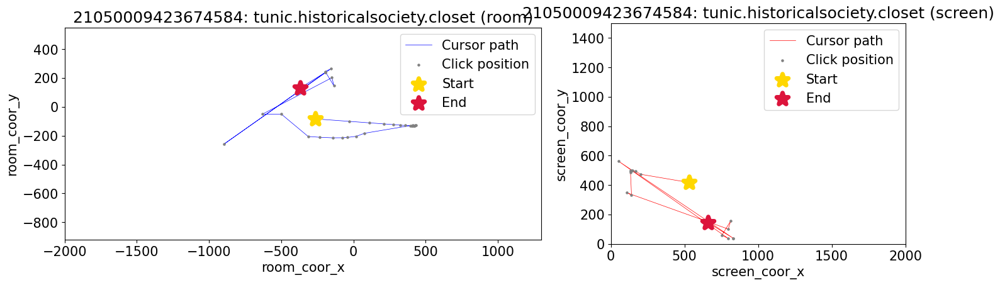

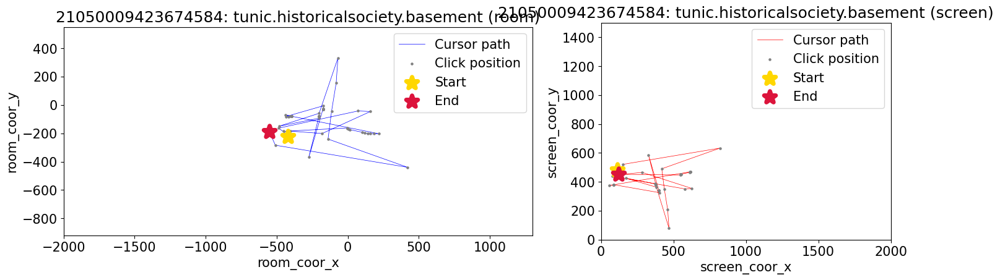

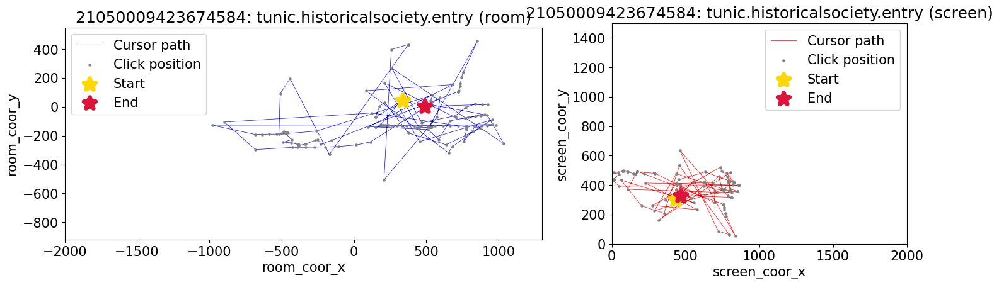

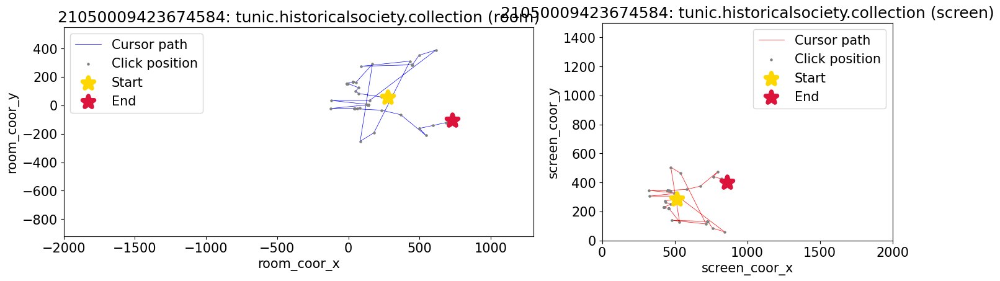

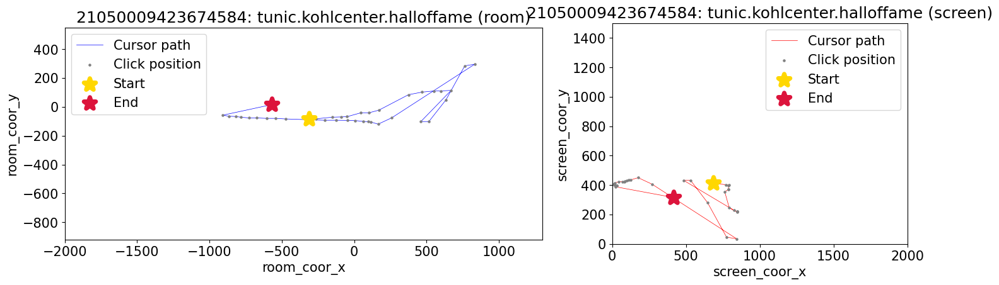

...

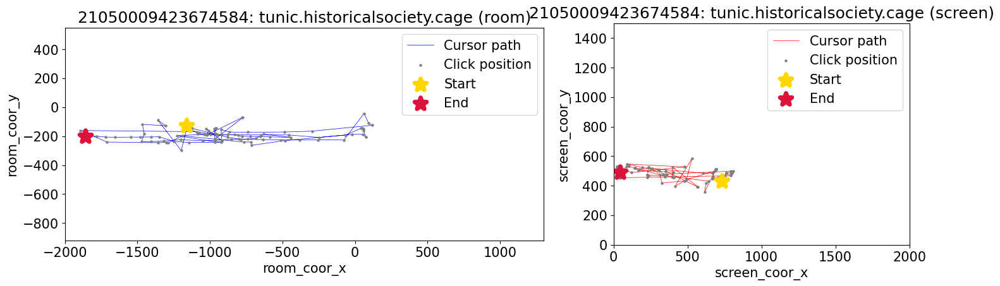

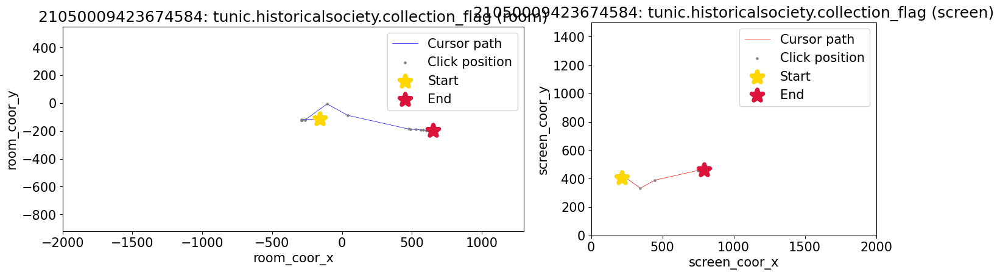

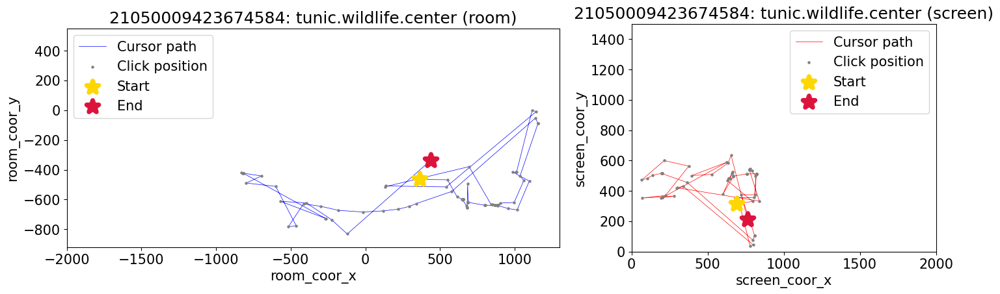

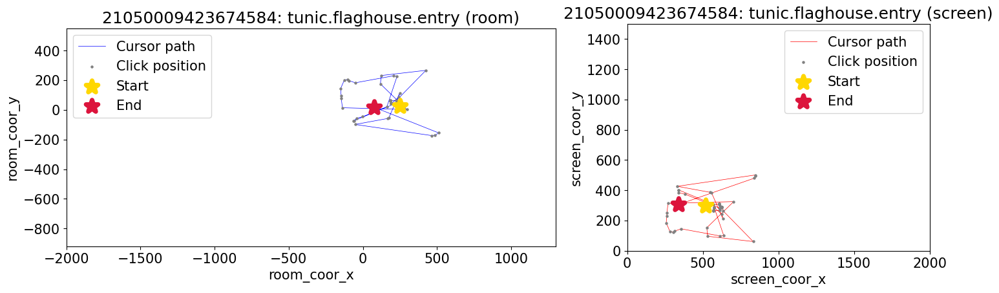

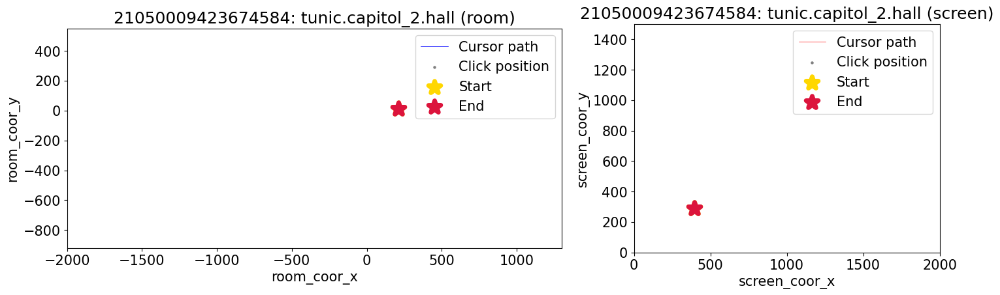

In [241]:
idx_dupl = train[['session_id', 'index']]
idx_dupl = idx_dupl[idx_dupl.duplicated()]
session_ids = train['session_id'].unique()
session_ids = session_ids[np.isin(session_ids, idx_duple['session_id'].unique() , invert=True)]

plot_geo_location(train, np.random.choice(session_ids))

보통 room에서는 (0,0) 지점을 많이 클릭하는 것 같고, screen에서는 좌측 하단을 많이 클릭하는 것 같습니다. 

이 위치들이 어떤 의미를 가지는 지는 [@Chris Deotte](https://www.kaggle.com/cdeotte) 님의 [Game Room Click EDA](https://www.kaggle.com/code/cdeotte/game-room-click-eda)에서 볼 수 있습니다. 보면 특정 사물들에서 좌표들의 밀집률이 높은 것으로 나타납니다. 

이 좌표들을 어떻게 활용할 지는 위 링크에서 댓글에 들어가면 Chris Deotte님이 답변하신 내용이 있습니다. event_name과 level, room_fqid를 정해둔 index를 잡아, 그 index의 session_id 별로 elapsed_time의 차이, 좌표들의 평균, 합, 표준편차 등으로 새로운 변수를 만들 수가 있습니다.

### Text
- text는 게임을 하는 동안 볼 수 있는 텍스트들을 나타냅니다. 여기서 이모티콘을 나타내는 16진수도 포함됩니다.
- text_fqid는 text의 고유번호값입니다.

In [242]:
print(f'train에서의 텍스트 고윳값 : ', len(train['text'].unique()))
print(f'test에서의 텍스트 고윳값 : ', len(test['text'].unique()))

train에서의 텍스트 고윳값 :  598
test에서의 텍스트 고윳값 :  496


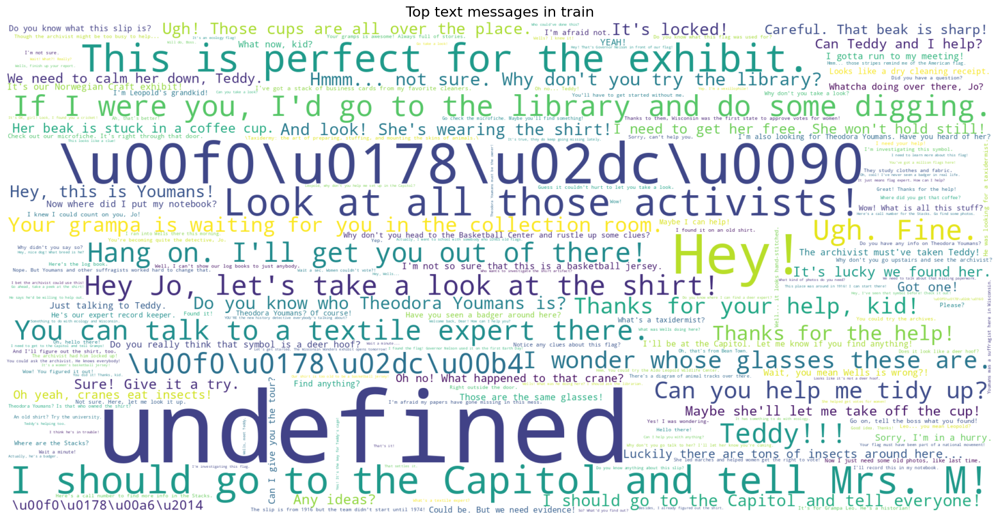

In [243]:
text_counts_train = train['text'].value_counts()
word_freq_train = dict(zip(text_counts_train.index.tolist(), text_counts_train.values.tolist()))
wordcloud_train = WordCloud(width=2000, height=1000, background_color='white').generate_from_frequencies(word_freq_train)
plt.figure(figsize=(20,10))
plt.imshow(wordcloud_train, interpolation='bilinear')
plt.title('Top text messages in train', fontsize=16)
plt.axis('off')
plt.show()

In [244]:
print(f'TOP-20 text messages : ')
stat = pd.DataFrame([train['text'].value_counts(), test['text'].value_counts()]).T
stat.columns = ['train', 'test']
stat = stat.sort_values('train', ascending=False)
stat.head(20).style.format(precision=0)

TOP-20 text messages : 


,train,test
undefined,355969,27
\u00f0\u0178\u02dc\u0090,48805,4
Hey!,47452,6
I should go to the Capitol and tell Mrs. M!,40463,4
This is perfect for the exhibit.,40218,4
Look at all those activists!,40215,4
"If I were you, I'd go to the library and do some digging.",39248,3
Ugh. Fine.,36009,5
\u00f0\u0178\u02dc\u00b4,35654,4
You can talk to a textile expert there.,35202,7


text의 값들을 보아하니 대사와 이모티콘을 16진수로 나타낸 것을 나타냅니다. 그리고 text 피처에서 undefined이 가장 빈도가 많습니다.

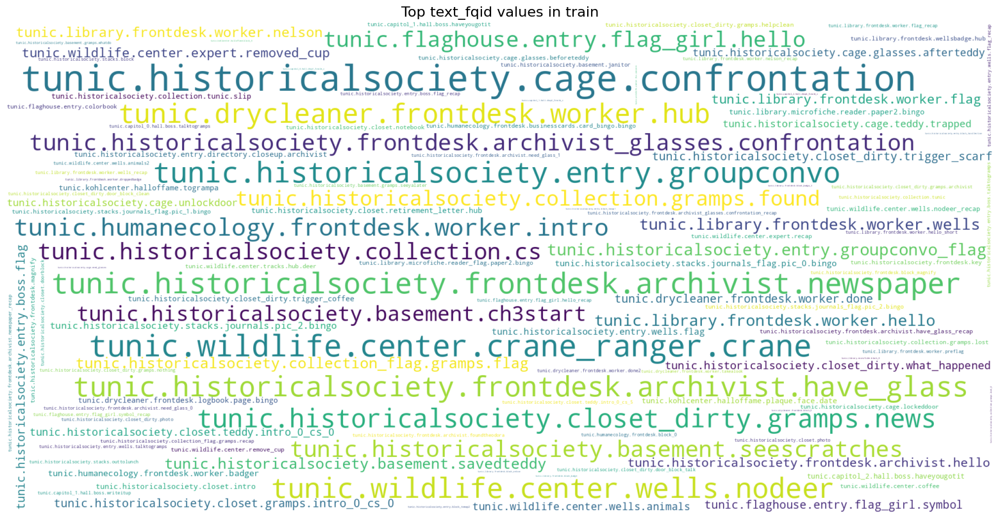

In [245]:
text_counts_train = train['text_fqid'].value_counts()
word_freq_train = dict(zip(text_counts_train.index.tolist(), text_counts_train.values.tolist()))
wordcloud_train = WordCloud(width=2000, height=1000, background_color='white').generate_from_frequencies(word_freq_train)
plt.figure(figsize=(20,10))
plt.imshow(wordcloud_train, interpolation='bilinear')
plt.title('Top text_fqid values in train', fontsize=16)
plt.axis('off')
plt.show()

In [246]:
print(f'TOP-20 text_fqid messages : ')
stat = pd.DataFrame([train['text_fqid'].value_counts(), test['text_fqid'].value_counts()]).T
stat.columns = ['train', 'test']
stat = stat.sort_values('train', ascending=False)
stat.head(20).style.format(precision=0)

TOP-20 text_fqid messages : 


,train,test
tunic.historicalsociety.cage.confrontation,666557,75
tunic.wildlife.center.crane_ranger.crane,470755,51
tunic.historicalsociety.frontdesk.archivist.newspaper,429762,54
tunic.historicalsociety.entry.groupconvo,427180,51
tunic.wildlife.center.wells.nodeer,399967,49
tunic.historicalsociety.frontdesk.archivist.have_glass,394908,48
tunic.drycleaner.frontdesk.worker.hub,362883,39
tunic.historicalsociety.closet_dirty.gramps.news,334439,42
tunic.humanecology.frontdesk.worker.intro,300110,37
tunic.historicalsociety.frontdesk.archivist_glasses.confrontation,263308,31


text와는 다르게 text_fqid는 다른 fqid와 비슷하게 text의 그룹을 나타납니다.

In [248]:
print(f'TOP-30 text_fqid and text combinations : ')
stat = pd.DataFrame([train[['text_fqid', 'text']].value_counts(), test[['text_fqid', 'text']].value_counts()]).T
stat.columns = ['train', 'test']
stat = stat.sort_values('train', ascending=False)
stat.head(30).style.format(precision=0)

TOP-30 text_fqid and text combinations : 


더나아가 어떤 text_fqid는 room_fqid와 fqid의 내용을 포함하고 있습니다.

In [249]:
train[['room_fqid', 'fqid', 'text_fqid']].dropna().drop_duplicates().head().style.hide_index()

/tmp/ipykernel_14/3019683365.py:1: FutureWarning: this method is deprecated in favour of `Styler.hide(axis="index")`
  train[['room_fqid', 'fqid', 'text_fqid']].dropna().drop_duplicates().head().style.hide_index()


room_fqid,fqid,text_fqid
tunic.historicalsociety.closet,intro,tunic.historicalsociety.closet.intro
tunic.historicalsociety.closet,gramps,tunic.historicalsociety.closet.gramps.intro_0_cs_0
tunic.historicalsociety.closet,teddy,tunic.historicalsociety.closet.teddy.intro_0_cs_0
tunic.historicalsociety.closet,teddy,tunic.historicalsociety.closet.teddy.intro_0_cs_5
tunic.historicalsociety.closet,photo,tunic.historicalsociety.closet.photo


나중에 학습할 때 room_fqid, fqid, text_fqid의 고윳값을 이용해보겠습니다.

### Page

page는 이벤트의 페이지를 나타냅니다. 데이터에 page가 결측값이 많지만 일단 한번 보겠습니다.

In [253]:
print('train에서의 page 비율 : ', round(train['page'].count() / len(train) * 100, 2), '%')
print('test에서의 page 비율 : ', round(test['page'].count() / len(test) * 100 , 2), '%')

train에서의 page 비율 :  2.15 %
test에서의 page 비율 :  4.1 %


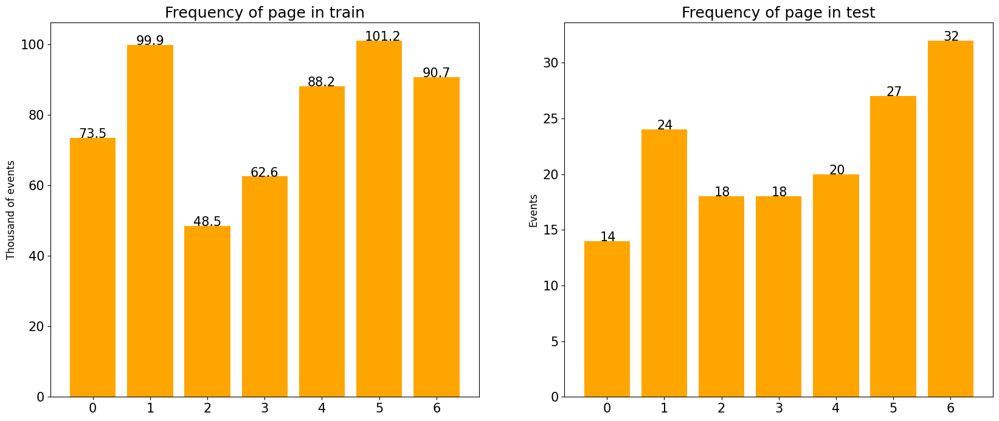

In [274]:
page_counts_train = train['page'].value_counts() / 1000
page_counts_test = test['page'].value_counts()

plt.figure(figsize=(20,8))
plt.subplot(1,2,1)
plt.bar(page_counts_train.index, page_counts_train.values, color='orange')
plt.ylabel('Thousand of events', fontsize=12)
plt.title('Frequency of page in train', fontsize=18)
for i, v in enumerate(page_counts_train.sort_index().values):
    plt.text(i-0.25, v, str(round(v, 1)))
plt.xticks()

plt.subplot(1,2,2)
plt.bar(page_counts_test.index, page_counts_test.values, color='orange')
plt.ylabel('Events', fontsize=12)
plt.title('Frequency of page in test', fontsize=18)
for i, v in enumerate(page_counts_test.sort_index().values):
    plt.text(i-0.125, v, str(int(v)))
plt.xticks()
plt.show()

### Hover

hover_duration은 화면에 얼마나 머물었는지 나타냅니다. 여기에는 2가지 타입이 있습니다.

- Object Hover

만약 사용자가 어떤 물체에 마우스 포인터를 가져다대면 기록이 시작되고 그 기록은 object_hover에 저장됩니다. 그 물체를 클릭한다면 object_click에 저장됩니다.

- Map Hover

사용자가 지도에 마우스 포인터를 가져다대면 기록이 시작되고 그 기록은 map_hover에 기록됩니다. 만약 지도를 클릭한다면 map_click에 저장됩니다.

모든 기록은 hover_duration에 기록됩니다.

In [276]:
print('train에서의 hover_duration 비율 : ', round(train['hover_duration'].count() / len(train) * 100 , 2), '%')
print('test에서의 hover_duration 비율 : ', round(test['hover_duration'].count() / len(test) * 100, 2), '%')

train에서의 hover_duration 비율 :  7.61 %
test에서의 hover_duration 비율 :  9.47 %


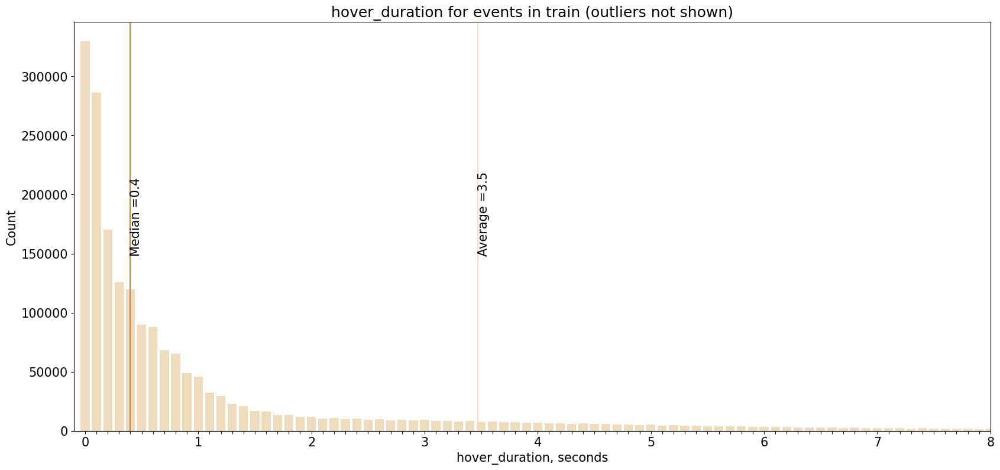

In [277]:
hover_duration_train = np.round(train[train['hover_duration'].notna()]['hover_duration'].astype(np.int32)/1000.0, 1)
hover_duration_test = np.round(test[test['hover_duration'].notna()]['hover_duration'].astype(np.int32)/1000.0, 1)

mean_hover_duration_train = hover_duration_train.mean()
median_hover_duration_train = hover_duration_train.median()
hover_duration_train_counts = np.round(hover_duration_train*10, 0).astype(np.int64).value_counts()

plt.figure(figsize=(20, 9))
g = sns.barplot(x=hover_duration_train_counts.index, y=np.round(hover_duration_train_counts.values, 0), color='wheat')
plt.title('hover_duration for events in train (outliers not shown)', fontsize=18)
g.set_xticklabels(['{}'.format(int(num/10)) if i % 10 == 0 else '' for i, num in enumerate(g.get_xticks())])
g.set(xlabel='hover_duration, seconds', ylabel='Count')
g.axvline(x=mean_hover_duration_train*10, color="peachpuff")
g.text(mean_hover_duration_train*10, 150000, f'Average ={round(mean_hover_duration_train, 1)}', rotation=90)
plt.axvline(x=median_hover_duration_train*10, color="peru")
plt.text(median_hover_duration_train*10, 150000, f'Median ={round(median_hover_duration_train, 1)}', rotation=90)
plt.xlim(-1, 8*10)
del mean_hover_duration_train, median_hover_duration_train, hover_duration_train_counts
plt.show()

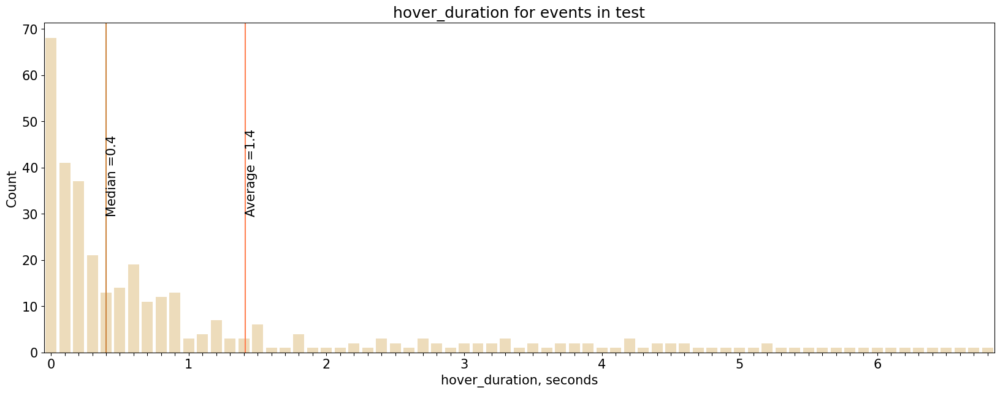

In [278]:
mean_hover_duration_test = hover_duration_test.mean()
median_hover_duration_test = hover_duration_test.median()
hover_duration_test_counts = np.round(hover_duration_test*10, 0).astype(np.int64).value_counts()

plt.figure(figsize=(20, 7))
g = sns.barplot(x=hover_duration_test_counts.index, y=hover_duration_test_counts.values, color='wheat')
plt.title('hover_duration for events in test', fontsize=18)
g.set_xticklabels(['{}'.format(int(num/10)) if i % 10 == 0 else '' for i, num in enumerate(g.get_xticks())])
g.set(xlabel='hover_duration, seconds', ylabel='Count')
g.axvline(x=mean_hover_duration_test*10, color="coral")
g.text(mean_hover_duration_test*10, 30, f'Average ={round(mean_hover_duration_test, 1)}', rotation=90)
g.axvline(x=median_hover_duration_test*10, color="peru")
g.text(median_hover_duration_test*10, 30, f'Median ={round(median_hover_duration_test, 1)}', rotation=90)
del mean_hover_duration_test, median_hover_duration_test, hover_duration_test_counts, hover_duration_train, hover_duration_test
plt.show()